In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!cp "/content/drive/MyDrive/CoralMaskUpload/CoralMask.zip" /content/

In [4]:
!unzip -q /content/CoralMask.zip -d /content/CoralMask

Generating masks: 100%|██████████| 38098/38098 [09:15<00:00, 68.53it/s]



Missing images: []
Cleaning up 0 invalid JSON files...

Visualizing sample results:


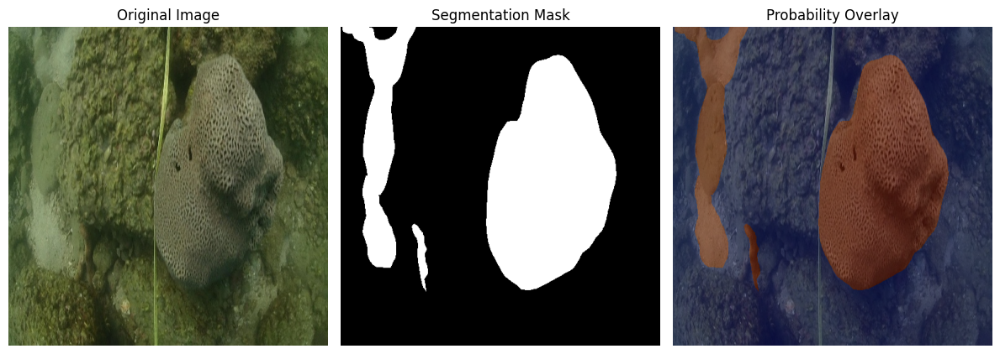

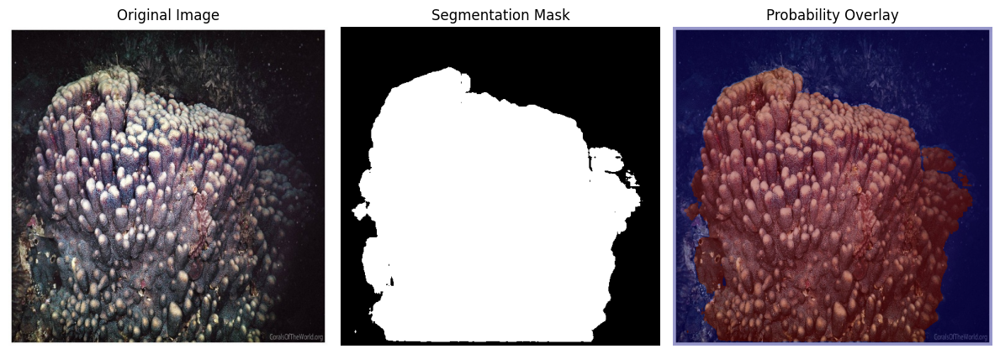

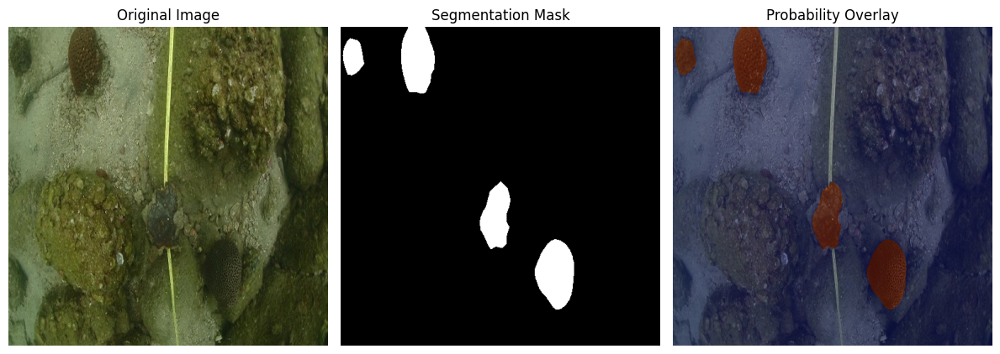

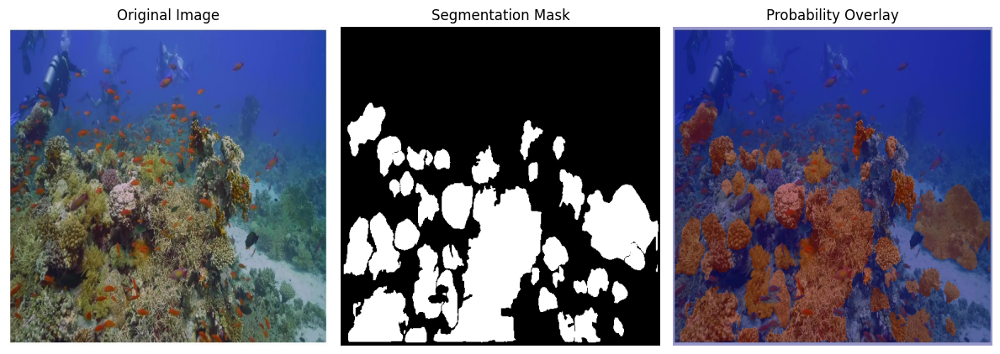

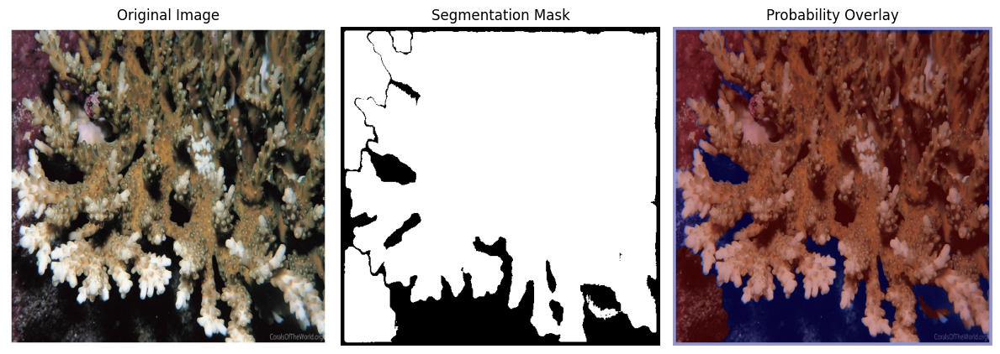


Dataset Validation Report:
Total images: 38098
Unannotated images: 0
Valid masks: 38098
Missing masks: 0
Empty masks: 0 (Deleted)
Class distribution - Coral: 4109941555, Background: 5877220557
Coral/Background ratio: 0.6993


Generating masks: 100%|██████████| 830/830 [00:22<00:00, 36.58it/s]



Missing images: []
Cleaning up 0 invalid JSON files...

Visualizing sample results:


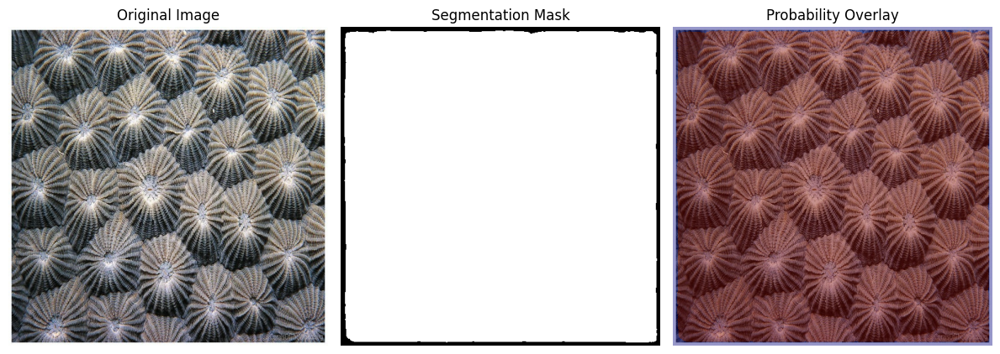

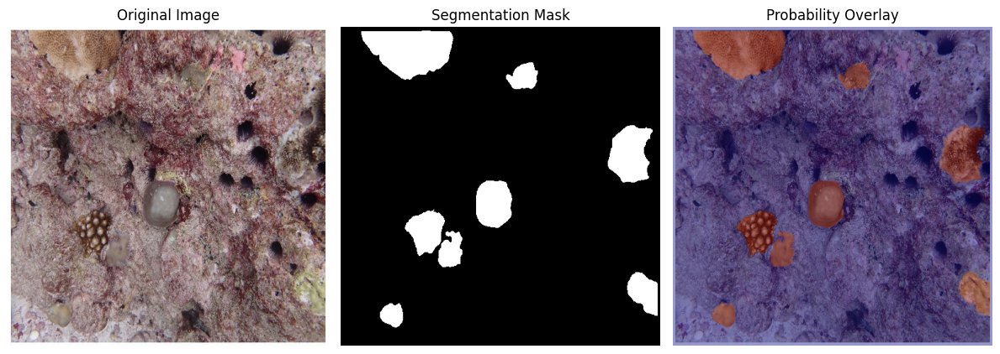

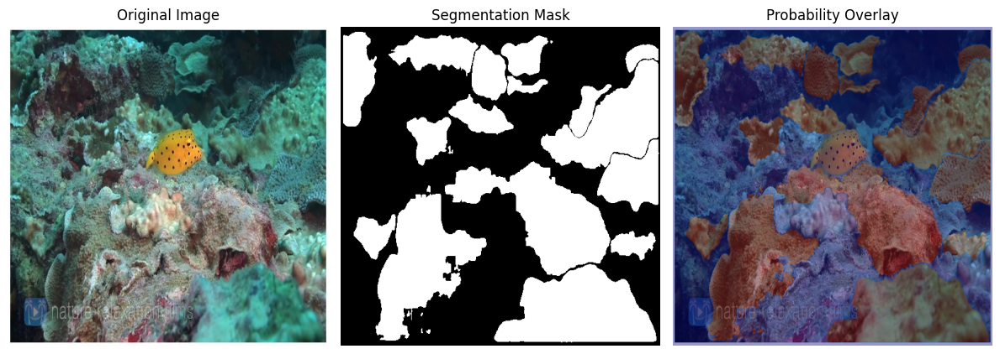

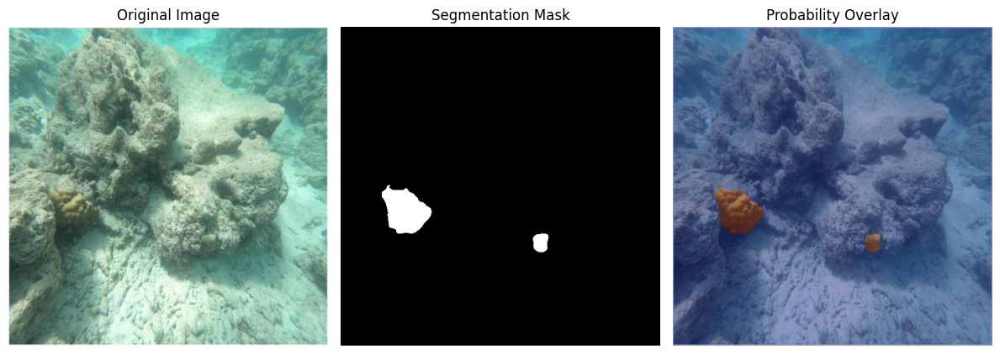

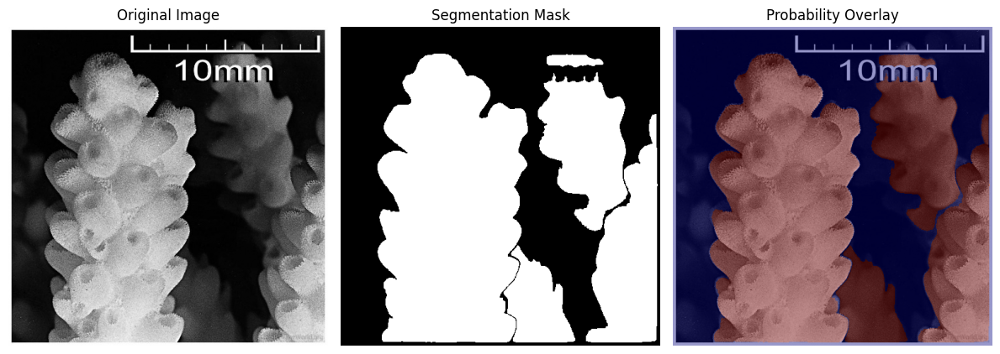


Dataset Validation Report:
Total images: 830
Unannotated images: 0
Valid masks: 830
Missing masks: 0
Empty masks: 0 (Deleted)
Class distribution - Coral: 68475597, Background: 149103923
Coral/Background ratio: 0.4592
Setup complete! Ready for model training.


In [5]:
#%% Imports & Configuration
import os
import json
import numpy as np
import cv2
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from pathlib import Path
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm
from pycocotools import mask as maskUtils
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt

%matplotlib inline

__all__ = ['CoralDataset']

# ====================== Configuration ======================
BASE_DIR = Path("/content/CoralMask/CoralMask")
DATASET_SPLITS = ["train", "test"]
IMAGE_EXTENSIONS = {'.jpg', '.jpeg', '.png'}
MASK_EXTENSION = '.png'
IMG_SIZE = (512, 512)
MAX_WORKERS = 8
NUM_SAMPLES_TO_VISUALIZE = 5
BATCH_SIZE = 16
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#%% 1. Enhanced Mask Generation with Underwater Preprocessing
class CoralPreprocessor:
    @staticmethod
    def underwater_correction(image):
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        cl = clahe.apply(l)
        merged = cv2.merge((cl, a, b))
        return cv2.cvtColor(merged, cv2.COLOR_LAB2BGR)

    @staticmethod
    def turbidity_simulation(image):
        image = cv2.GaussianBlur(image, (5, 5), 0)
        noise = np.random.normal(0, 25, image.shape).astype(np.uint8)
        return cv2.addWeighted(image, 0.75, noise, 0.25, 0)

def process_single_json(json_path, image_dir, mask_dir):
    try:
        with open(json_path, 'r') as f:
            data = json.load(f)

        image_file = data['image']['file_name']
        image_path = image_dir / image_file
        if not image_path.exists():
            print(f"Missing image: {image_file}")
            return None

        raw_image = cv2.imread(str(image_path))
        if raw_image is None:
            print(f"Failed to load image: {image_path}")
            return None

        resized_image = cv2.resize(raw_image, IMG_SIZE)

        processed_dir = image_dir.parent / "images_processed"
        processed_dir.mkdir(parents=True, exist_ok=True)
        processed_image_path = processed_dir / image_file
        cv2.imwrite(str(processed_image_path), resized_image)

        orig_h, orig_w = data['image']['height'], data['image']['width']
        combined_mask = np.zeros((orig_h, orig_w), dtype=np.uint8)

        annotations = data.get('annotations', [])
        if not annotations:
            print(f"Warning: No annotations for {image_file}")
            return None

        for ann in annotations:
            segmentation = ann.get('segmentation')
            if segmentation:
                ann_mask = maskUtils.decode(segmentation)
                if ann_mask is not None:
                    combined_mask = np.maximum(combined_mask, ann_mask)

        if np.sum(combined_mask) == 0:
            print(f"Warning: Empty mask for {image_file}")
            return None

        if combined_mask.dtype != np.uint8:
            combined_mask = (combined_mask > 0).astype(np.uint8)

        resized_mask = cv2.resize(combined_mask, IMG_SIZE, interpolation=cv2.INTER_NEAREST)
        mask_path = mask_dir / f"{json_path.stem}_mask{MASK_EXTENSION}"
        cv2.imwrite(str(mask_path), (resized_mask * 255).astype(np.uint8))

        return (processed_image_path, mask_path)

    except Exception as e:
        print(f"Error processing {json_path.name}: {str(e)}")
        return None

#%% 2. Dataset Validation & Class Analysis
def validate_dataset(image_dir, mask_dir, json_dir):
    missing_masks = []
    unannotated_images = []
    empty_masks = []
    class_dist = {'coral': 0, 'background': 0}

    total_images = len(list(image_dir.glob('*')))

    for img_path in image_dir.glob('*'):
        json_path = json_dir / f"{img_path.stem}.json"
        mask_path = mask_dir / f"{img_path.stem}_mask{MASK_EXTENSION}"

        if not json_path.exists():
            unannotated_images.append(img_path.name)
            continue

        if not mask_path.exists():
            missing_masks.append(img_path.name)
            continue

        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
        if np.sum(mask) == 0:
            empty_masks.append(img_path.name)
            mask_path.unlink()
            continue

        class_dist['coral'] += np.sum(mask > 0)
        class_dist['background'] += np.sum(mask == 0)

    print(f"\nDataset Validation Report:")
    print(f"Total images: {total_images}")
    print(f"Unannotated images: {len(unannotated_images)}")
    print(f"Valid masks: {total_images - len(missing_masks) - len(unannotated_images)}")
    print(f"Missing masks: {len(missing_masks)}")
    print(f"Empty masks: {len(empty_masks)} (Deleted)")
    print(f"Class distribution - Coral: {class_dist['coral']}, Background: {class_dist['background']}")
    if class_dist['background'] > 0:
        ratio = class_dist['coral'] / class_dist['background']
        print(f"Coral/Background ratio: {ratio:.4f}")
    else:
        print("Coral/Background ratio: Undefined")

#%% 3. Generate Masks Function
def generate_masks(dataset_split):
    dataset_dir = BASE_DIR / dataset_split
    image_dir = dataset_dir / "images"
    json_dir = dataset_dir / "jsons"
    mask_dir = dataset_dir / "masks"

    mask_dir.mkdir(parents=True, exist_ok=True)
    json_files = list(json_dir.glob("*.json"))

    missing_images = []
    bad_jsons = []

    results = []
    with ThreadPoolExecutor(max_workers=MAX_WORKERS) as executor:
        futures = {executor.submit(process_single_json, p, image_dir, mask_dir): p for p in json_files}
        for future in tqdm(futures, desc="Generating masks"):
            if (result := future.result()) is None:
                bad_json = futures[future]
                bad_jsons.append(bad_json)
                with open(bad_json, 'r') as f:
                    data = json.load(f)
                missing_images.append(data['image']['file_name'])
            else:
                results.append(result)

    print(f"\nMissing images: {missing_images}")
    print(f"Cleaning up {len(bad_jsons)} invalid JSON files...")
    for bad_json in bad_jsons:
        bad_json.unlink()

    print("\nVisualizing sample results:")
    for idx in np.random.choice(len(results), min(NUM_SAMPLES_TO_VISUALIZE, len(results)), replace=False):
        visualize_comparison(*results[idx])

#%% 4. Visualization Function
def visualize_comparison(image_path, mask_path):
    plt.figure(figsize=(12, 6))

    image = cv2.cvtColor(cv2.imread(str(image_path)), cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, IMG_SIZE)
    image = np.clip(image / 255.0, 0, 1)
    mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)

    norm_mask = mask.astype(float)/float(mask.max()) if mask.max() > 0 else mask

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask, cmap='gray')
    plt.title("Segmentation Mask")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(image)
    plt.imshow(norm_mask, alpha=0.4, cmap='jet')
    plt.title("Probability Overlay")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

#%% 5. Dataset Class
class CoralDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform

        self.image_paths = []
        for p in image_dir.glob('*'):
            if p.suffix.lower() not in IMAGE_EXTENSIONS:
                continue
            mask_path = mask_dir / f"{p.stem}_mask{MASK_EXTENSION}"
            if not mask_path.exists():
                raise FileNotFoundError(f"Missing mask for {p.name}")
            self.image_paths.append(p)

        self.pos_weight = self._calculate_class_weights()

    def _calculate_class_weights(self):
        coral_pixels = 0
        background_pixels = 0
        smooth = 1e-6

        for mask_path in self.mask_dir.glob('*'):
            mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
            coral_pixels += np.sum(mask > 0)
            background_pixels += np.sum(mask == 0)

        pos_weight = (background_pixels + smooth) / (coral_pixels + smooth)
        return torch.tensor(pos_weight, dtype=torch.float32)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        mask_path = self.mask_dir / f"{img_path.stem}_mask{MASK_EXTENSION}"

        image = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)
        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
        mask = (mask > 0).astype(np.uint8)

        if self.transform:
            transformed = self.transform(image=image, mask=mask)
            image = transformed['image']
            mask = transformed['mask']
            if mask.dim() == 2:
                mask = mask.unsqueeze(0)
        else:
            image = cv2.resize(image, IMG_SIZE)
            mask = cv2.resize(mask, IMG_SIZE, interpolation=cv2.INTER_NEAREST)
            image = torch.from_numpy(image).permute(2, 0, 1).float() / 255.0
            mask = torch.from_numpy(mask).float().unsqueeze(0)

        return image, mask

#%% 6. Albumentations Transform
train_transform = A.Compose([
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
    ToTensorV2()
])

#%% 7. Main Execution
if __name__ == "__main__":
    torch.backends.cudnn.benchmark = True
    for split in DATASET_SPLITS:
        generate_masks(split)
        validate_dataset(
            BASE_DIR/split/"images_processed",
            BASE_DIR/split/"masks",
            BASE_DIR/split/"jsons"
        )

    print("Setup complete! Ready for model training.")

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SEBlock(nn.Module):
    def __init__(self, channels, reduction=16):
        super().__init__()
        self.fc1 = nn.Linear(channels, channels // reduction)
        self.fc2 = nn.Linear(channels // reduction, channels)

    def forward(self, x):
        batch, c, h, w = x.size()
        y = F.adaptive_avg_pool2d(x, 1).view(batch, c)
        y = F.relu(self.fc1(y))
        y = torch.sigmoid(self.fc2(y)).view(batch, c, 1, 1)
        return x * y

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        mid_channels = mid_channels or out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            SEBlock(mid_channels),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            SEBlock(out_channels)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]
        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class UNet(nn.Module):
    def __init__(self, n_channels=3, n_classes=1, bilinear=True):
        super(UNet, self).__init__()
        self.inc = DoubleConv(n_channels, 32)
        self.down1 = Down(32, 64)
        self.down2 = Down(64, 128)
        self.down3 = Down(128, 256)
        factor = 2 if bilinear else 1
        self.down4 = Down(256, 512 // factor)
        self.up1 = Up(512, 256 // factor, bilinear)
        self.up2 = Up(256, 128 // factor, bilinear)
        self.up3 = Up(128, 64 // factor, bilinear)
        self.up4 = Up(64, 32, bilinear)
        self.outc = OutConv(32, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        return self.outc(x)

In [7]:
# 1. Imports
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models.segmentation import deeplabv3_mobilenet_v3_large, DeepLabV3_MobileNet_V3_Large_Weights

# 2. ASPP First
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ASPP, self).__init__()
        self.atrous_block1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.atrous_block6 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=6, dilation=6, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.atrous_block12 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=12, dilation=12, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.atrous_block18 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=18, dilation=18, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.image_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d((1, 1)),
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.conv1 = nn.Conv2d(out_channels * 5, out_channels, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        size = x.shape[-2:]
        image_features = self.image_pool(x)
        image_features = F.interpolate(image_features, size=size, mode='bilinear', align_corners=False)
        out = torch.cat([
            self.atrous_block1(x),
            self.atrous_block6(x),
            self.atrous_block12(x),
            self.atrous_block18(x),
            image_features
        ], dim=1)
        out = self.conv1(out)
        out = self.bn1(out)
        out = self.relu(out)
        return self.dropout(out)

# 3. Decoder Class (after ASPP is defined)
class DeepLabV3PlusDecoder(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        base_model = deeplabv3_mobilenet_v3_large(weights=DeepLabV3_MobileNet_V3_Large_Weights.DEFAULT)
        self.backbone = base_model.backbone
        self.aspp = ASPP(960, 256)

        self.low_level_proj = nn.Sequential(
            nn.Conv2d(40, 48, kernel_size=1, bias=False),
            nn.BatchNorm2d(48),
            nn.ReLU(inplace=True)
        )

        self.decoder = nn.Sequential(
            nn.Conv2d(256 + 48, 256, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, num_classes, kernel_size=1)
        )

    def forward(self, x):
        input_size = x.shape[-2:]
        low_level_feat = None
        for name, module in self.backbone.named_children():
            x = module(x)
            if name == "4":
                low_level_feat = x
            if name == "16":
                break

        high_level_feat = self.aspp(x)
        low_level_feat = self.low_level_proj(low_level_feat)

        high_level_feat = F.interpolate(high_level_feat, size=low_level_feat.shape[2:], mode="bilinear", align_corners=False)
        x = torch.cat([high_level_feat, low_level_feat], dim=1)
        x = self.decoder(x)
        x = F.interpolate(x, size=input_size, mode="bilinear", align_corners=False)
        return x

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models.resnet import BasicBlock


def conv3x3(in_planes, out_planes, stride=1):
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride, padding=1, bias=False)

class SafeBasicBlock(nn.Module):
    def __init__(self, inplanes, planes):
        super().__init__()
        self.conv1 = conv3x3(inplanes, planes)
        self.bn1 = nn.BatchNorm2d(planes)
        self.relu = nn.ReLU(inplace=False)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.BatchNorm2d(planes)

        self.downsample = None
        if inplanes != planes:
            self.downsample = nn.Sequential(
                nn.Conv2d(inplanes, planes, kernel_size=1, bias=False),
                nn.BatchNorm2d(planes)
            )

    def forward(self, x):
        identity = x
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        if self.downsample is not None:
            identity = self.downsample(identity)
        out = out + identity
        return self.relu(out)


BasicBlock = SafeBasicBlock


class HRNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, num_blocks):
        super().__init__()
        self.blocks = nn.Sequential(
            *[BasicBlock(in_channels if i == 0 else out_channels, out_channels) for i in range(num_blocks)]
        )

    def forward(self, x):
        return self.blocks(x)

class FuseLayer(nn.Module):
    def __init__(self, num_branches, channels):
        super().__init__()
        self.num_branches = num_branches
        self.channels = channels
        self.fuse_layers = nn.ModuleList()

        for i in range(num_branches):
            fuse = nn.ModuleList()
            for j in range(num_branches):
                if i == j:
                    fuse.append(nn.Identity())
                elif i < j:
                    fuse.append(nn.Sequential(
                        nn.Conv2d(channels[j], channels[i], 1, bias=False),
                        nn.BatchNorm2d(channels[i]),
                        nn.Upsample(scale_factor=2**(j - i), mode='bilinear', align_corners=True)
                    ))
                else:
                    downs = []
                    for k in range(i - j):
                        in_ch = channels[j] if k == 0 else channels[i]
                        downs.append(nn.Sequential(
                            nn.Conv2d(in_ch, channels[i], 3, stride=2, padding=1, bias=False),
                            nn.BatchNorm2d(channels[i]),
                            nn.ReLU(inplace=False)
                        ))
                    fuse.append(nn.Sequential(*downs))
            self.fuse_layers.append(fuse)

    def forward(self, x):
        fused = []
        for i in range(self.num_branches):
            y = self.fuse_layers[i][0](x[0])
            for j in range(1, self.num_branches):
                y = y + self.fuse_layers[i][j](x[j])
            fused.append(F.relu(y))
        return fused

class HRStage(nn.Module):
    def __init__(self, num_branches, num_blocks, channels):
        super().__init__()
        self.branches = nn.ModuleList([
            HRNetBlock(channels[i], channels[i], num_blocks) for i in range(num_branches)
        ])
        self.fuse = FuseLayer(num_branches, channels)

    def forward(self, x):
        x = [branch(xi) for branch, xi in zip(self.branches, x)]
        x = self.fuse(x)
        return x

class HRNetV2(nn.Module):
    def __init__(self, in_channels=3, num_classes=1):
        super().__init__()
        self.stem = nn.Sequential(
            conv3x3(in_channels, 64, stride=2),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False),
            conv3x3(64, 64, stride=2),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False)
        )

        self.stage1 = HRNetBlock(64, 64, num_blocks=4)

        self.transition1 = nn.ModuleList([
            nn.Identity(),
            nn.Sequential(
                conv3x3(64, 128, stride=2),
                nn.BatchNorm2d(128),
                nn.ReLU(inplace=False)
            )
        ])

        self.stage2 = HRStage(num_branches=2, num_blocks=4, channels=[64, 128])

        self.transition2 = nn.ModuleList([
            nn.Identity(),
            nn.Identity(),
            nn.Sequential(
                conv3x3(128, 256, stride=2),
                nn.BatchNorm2d(256),
                nn.ReLU(inplace=False)
            )
        ])

        self.stage3 = HRStage(num_branches=3, num_blocks=4, channels=[64, 128, 256])

        self.transition3 = nn.ModuleList([
            nn.Identity(),
            nn.Identity(),
            nn.Identity(),
            nn.Sequential(
                conv3x3(256, 512, stride=2),
                nn.BatchNorm2d(512),
                nn.ReLU(inplace=False)
            )
        ])

        self.stage4 = HRStage(num_branches=4, num_blocks=4, channels=[64, 128, 256, 512])

        self.head = nn.Sequential(
            nn.Conv2d(64 + 128 + 256 + 512, 512, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=False),
            nn.Conv2d(512, num_classes, 1)
        )

    def forward(self, x):
        B, C, H, W = x.shape
        x = self.stem(x)
        x = self.stage1(x)

        x_list = [self.transition1[0](x), self.transition1[1](x)]
        x_list = self.stage2(x_list)

        x_list = [self.transition2[i](x_list[i]) for i in range(2)] + [self.transition2[2](x_list[1])]
        x_list = self.stage3(x_list)

        x_list = [self.transition3[i](x_list[i]) for i in range(3)] + [self.transition3[3](x_list[2])]
        x_list = self.stage4(x_list)

        # Upsample all to 1/4 resolution (same as x_list[0]) and concatenate
        x_up = [F.interpolate(feat, size=x_list[0].shape[2:], mode='bilinear', align_corners=True) for feat in x_list]
        x_cat = torch.cat(x_up, dim=1)

        out = self.head(x_cat)
        out = F.interpolate(out, size=(H, W), mode='bilinear', align_corners=True)
        return out


In [9]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from einops import rearrange


# ------------------------------
# 1. Patch Embedding (Conv-based)
# ------------------------------
class OverlapPatchEmbedding(nn.Module):
    def __init__(self, in_channels, embed_dim, patch_size=7, stride=4):
        super().__init__()
        self.proj = nn.Conv2d(in_channels, embed_dim, patch_size, stride, patch_size // 2)
        self.norm = nn.LayerNorm(embed_dim)

    def forward(self, x):
        x = self.proj(x)  # B x C x H' x W'
        _, _, H, W = x.shape
        x = rearrange(x, 'b c h w -> b (h w) c')
        x = self.norm(x)
        return x, H, W


# ------------------------------
# 2. Efficient Self-Attention
# ------------------------------
class EfficientSelfAttention(nn.Module):
    def __init__(self, dim, num_heads=8, sr_ratio=1):
        super().__init__()
        self.num_heads = num_heads
        self.head_dim = dim // num_heads
        self.scale = self.head_dim ** -0.5

        self.q = nn.Linear(dim, dim)
        self.kv = nn.Linear(dim, dim * 2)

        self.sr_ratio = sr_ratio
        if sr_ratio > 1:
            self.sr = nn.Conv2d(dim, dim, kernel_size=sr_ratio, stride=sr_ratio)
            self.norm = nn.LayerNorm(dim)

        self.proj = nn.Linear(dim, dim)

    def forward(self, x, H, W):
        B, N, C = x.shape
        q = self.q(x).reshape(B, N, self.num_heads, self.head_dim).permute(0, 2, 1, 3)

        if self.sr_ratio > 1:
            x_ = x.permute(0, 2, 1).reshape(B, C, H, W)
            x_ = self.sr(x_).reshape(B, C, -1).permute(0, 2, 1)
            x_ = self.norm(x_)
        else:
            x_ = x

        kv = self.kv(x_).reshape(B, -1, 2, self.num_heads, self.head_dim).permute(2, 0, 3, 1, 4)
        k, v = kv[0], kv[1]  # each: (B, heads, tokens, head_dim)

        attn = (q @ k.transpose(-2, -1)) * self.scale
        attn = attn.softmax(dim=-1)

        out = (attn @ v).transpose(1, 2).reshape(B, N, C)
        return self.proj(out)


# ------------------------------
# 3. Mix Feed-Forward Network
# ------------------------------
class MixFFN(nn.Module):
    def __init__(self, dim, hidden_dim):
        super().__init__()
        self.fc1 = nn.Linear(dim, hidden_dim)
        self.dwconv = nn.Conv2d(hidden_dim, hidden_dim, 3, padding=1, groups=hidden_dim)
        self.act = nn.GELU()
        self.fc2 = nn.Linear(hidden_dim, dim)

    def forward(self, x, H, W):
        x = self.fc1(x)
        x = self.act(x)
        x = rearrange(x, 'b (h w) c -> b c h w', h=H, w=W)
        x = self.dwconv(x)
        x = rearrange(x, 'b c h w -> b (h w) c')
        x = self.fc2(x)
        return x


# ------------------------------
# 4. Transformer Block
# ------------------------------
class TransformerEncoderBlock(nn.Module):
    def __init__(self, dim, num_heads, sr_ratio=1, mlp_ratio=4):
        super().__init__()
        self.norm1 = nn.LayerNorm(dim)
        self.attn = EfficientSelfAttention(dim, num_heads, sr_ratio)
        self.norm2 = nn.LayerNorm(dim)
        self.ffn = MixFFN(dim, int(dim * mlp_ratio))

    def forward(self, x, H, W):
        x = x + self.attn(self.norm1(x), H, W)
        x = x + self.ffn(self.norm2(x), H, W)
        return x


# ------------------------------
# 5. MiT Backbone (4 Stages)
# ------------------------------
class MiTBackbone(nn.Module):
    def __init__(self, in_channels=3, embed_dims=[64, 128, 320, 512], depths=[2, 2, 2, 2],
                 num_heads=[1, 2, 5, 8], sr_ratios=[8, 4, 2, 1]):
        super().__init__()
        self.stages = nn.ModuleList()
        self.blocks = nn.ModuleList()

        for i in range(4):
            patch_embed = OverlapPatchEmbedding(
                in_channels if i == 0 else embed_dims[i - 1],
                embed_dims[i],
                patch_size=7 if i == 0 else 3,
                stride=4 if i == 0 else 2
            )
            self.stages.append(patch_embed)
            self.blocks.append(
                nn.Sequential(*[
                    TransformerEncoderBlock(embed_dims[i], num_heads[i], sr_ratios[i])
                    for _ in range(depths[i])
                ])
            )

    def forward(self, x):
        features = []
        for stage, block in zip(self.stages, self.blocks):
            x, H, W = stage(x)
            for b in block:
                x = b(x, H, W)
            x = rearrange(x, 'b (h w) c -> b c h w', h=H, w=W)
            features.append(x)
        return features  # [P1, P2, P3, P4]


# ------------------------------
# 6. MLP Decoder
# ------------------------------
class MLPDecoder(nn.Module):
    def __init__(self, in_channels=[64, 128, 320, 512], embedding_dim=256, num_classes=1):
        super().__init__()
        self.linear_c = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_ch, embedding_dim, 1),
                nn.BatchNorm2d(embedding_dim),
                nn.ReLU(inplace=False)
            ) for in_ch in in_channels
        ])
        self.fuse = nn.Sequential(
            nn.Conv2d(embedding_dim * 4, embedding_dim, 1),
            nn.BatchNorm2d(embedding_dim),
            nn.ReLU(inplace=False),
            nn.Conv2d(embedding_dim, num_classes, 1)
        )

    def forward(self, features):
        _, _, H, W = features[0].shape
        resized = [
            F.interpolate(self.linear_c[i](feat), size=(H, W), mode='bilinear', align_corners=False)
            for i, feat in enumerate(features)
        ]
        fused = torch.cat(resized, dim=1)
        return self.fuse(fused)


# ------------------------------
# 7. Full SegFormer Model
# ------------------------------
class SegFormer(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        self.encoder = MiTBackbone()
        self.decoder = MLPDecoder(num_classes=num_classes)

    def forward(self, x):
        H, W = x.shape[2:]
        features = self.encoder(x)
        logits = self.decoder(features)
        return F.interpolate(logits, size=(H, W), mode='bilinear', align_corners=False)


In [10]:

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models import resnet18, ResNet18_Weights


# ------------------------
# 1. Attention Refinement Module (ARM)
# ------------------------
class AttentionRefinementModule(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, 3, padding=1, bias=False),
            nn.BatchNorm2d(in_channels),
            nn.ReLU(inplace=False)
        )
        self.attn = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, in_channels, 1, bias=False),
            nn.BatchNorm2d(in_channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.conv(x)
        attn = self.attn(x)
        return x * attn


# ------------------------
# 2. Feature Fusion Module (FFM)
# ------------------------
class FeatureFusionModule(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.convblk = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=False)
        )
        self.attn = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(out_channels, out_channels // 4, 1, bias=False),
            nn.ReLU(inplace=False),
            nn.Conv2d(out_channels // 4, out_channels, 1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        feat = self.convblk(x)
        attn = self.attn(feat)
        return feat + feat * attn


# ------------------------
# 3. Spatial Path
# ------------------------
class SpatialPath(nn.Module):
    def __init__(self):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(3, 64, 7, stride=2, padding=3, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False),
            nn.Conv2d(64, 64, 3, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False),
            nn.Conv2d(64, 64, 3, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False)
        )

    def forward(self, x):
        return self.block(x)


# ------------------------
# 4. BiSeNet v1
# ------------------------
class BiSeNet(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        backbone = resnet18(weights=None)
        self.context_layer3 = backbone.layer3  # 1/16
        self.context_layer4 = backbone.layer4  # 1/32

        self.conv1 = nn.Sequential(
            backbone.conv1,
            backbone.bn1,
            backbone.relu,
            backbone.maxpool,
            backbone.layer1,
            backbone.layer2
        )

        self.spatial_path = SpatialPath()

        self.arm16 = AttentionRefinementModule(256)
        self.arm32 = AttentionRefinementModule(512)

        self.global_avg_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(512, 512, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=False)
        )

        self.reduce_feat32 = nn.Conv2d(512, 256, 1, bias=False)

        self.ffm = FeatureFusionModule(64 + 256, 256)

        self.output_conv = nn.Conv2d(256, num_classes, 1)

    def forward(self, x):
        size = x.size()[2:]

        # Spatial
        sp = self.spatial_path(x)

        # Context
        feat = self.conv1(x)
        feat16 = self.context_layer3(feat)
        feat32 = self.context_layer4(feat16)

        # Global Context
        global_context = self.global_avg_pool(feat32)
        global_context = F.interpolate(global_context, size=feat32.shape[2:], mode='bilinear', align_corners=True)
        feat32 = self.arm32(feat32) + global_context
        feat16 = self.arm16(feat16)

        # Upsample context path to 1/8
        feat32_up = F.interpolate(feat32, size=feat16.shape[2:], mode='bilinear', align_corners=True)
        feat32_up = self.reduce_feat32(feat32_up)  # Channel alignment
        context_up = feat16 + feat32_up
        context_up = F.interpolate(context_up, size=sp.shape[2:], mode='bilinear', align_corners=True)

        # Fuse
        fused = self.ffm(torch.cat([sp, context_up], dim=1))

        # Output
        out = self.output_conv(fused)
        out = F.interpolate(out, size=size, mode='bilinear', align_corners=True)
        return out


In [11]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False)
        )

    def forward(self, x):
        return self.double_conv(x)


class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=3, num_classes=1):
        super().__init__()

        nb_filter = [32, 64, 128, 256, 512]  # Reduced filters to avoid OOM

        self.conv0_0 = ConvBlock(in_channels, nb_filter[0])
        self.conv1_0 = ConvBlock(nb_filter[0], nb_filter[1])
        self.conv2_0 = ConvBlock(nb_filter[1], nb_filter[2])
        self.conv3_0 = ConvBlock(nb_filter[2], nb_filter[3])
        self.conv4_0 = ConvBlock(nb_filter[3], nb_filter[4])

        self.conv0_1 = ConvBlock(nb_filter[0] + nb_filter[1], nb_filter[0])
        self.conv1_1 = ConvBlock(nb_filter[1] + nb_filter[2], nb_filter[1])
        self.conv2_1 = ConvBlock(nb_filter[2] + nb_filter[3], nb_filter[2])
        self.conv3_1 = ConvBlock(nb_filter[3] + nb_filter[4], nb_filter[3])

        self.conv0_2 = ConvBlock(nb_filter[0]*2 + nb_filter[1], nb_filter[0])
        self.conv1_2 = ConvBlock(nb_filter[1]*2 + nb_filter[2], nb_filter[1])
        self.conv2_2 = ConvBlock(nb_filter[2]*2 + nb_filter[3], nb_filter[2])

        self.conv0_3 = ConvBlock(nb_filter[0]*3 + nb_filter[1], nb_filter[0])
        self.conv1_3 = ConvBlock(nb_filter[1]*3 + nb_filter[2], nb_filter[1])

        self.conv0_4 = ConvBlock(nb_filter[0]*4 + nb_filter[1], nb_filter[0])

        self.final = nn.Conv2d(nb_filter[0], num_classes, kernel_size=1)

    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(F.max_pool2d(x0_0, 2))
        x0_1 = self.conv0_1(torch.cat([x0_0, F.interpolate(x1_0, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        x2_0 = self.conv2_0(F.max_pool2d(x1_0, 2))
        x1_1 = self.conv1_1(torch.cat([x1_0, F.interpolate(x2_0, x1_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, F.interpolate(x1_1, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        x3_0 = self.conv3_0(F.max_pool2d(x2_0, 2))
        x2_1 = self.conv2_1(torch.cat([x2_0, F.interpolate(x3_0, x2_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, F.interpolate(x2_1, x1_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, F.interpolate(x1_2, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        x4_0 = self.conv4_0(F.max_pool2d(x3_0, 2))
        x3_1 = self.conv3_1(torch.cat([x3_0, F.interpolate(x4_0, x3_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, F.interpolate(x3_1, x2_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, F.interpolate(x2_2, x1_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, F.interpolate(x1_3, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        return self.final(x0_4)


In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class AttentionGate(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(AttentionGate, self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1),
            nn.GroupNorm(4, F_int)
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1),
            nn.GroupNorm(4, F_int)
        )
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1),
            nn.GroupNorm(1, 1),
            nn.Sigmoid()
        )
        self.relu = nn.ReLU(inplace=False)

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi


class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False)
        )

    def forward(self, x):
        return self.double_conv(x)


class UpBlock(nn.Module):
    def __init__(self, in_channels, bridge_channels, out_channels):
        super().__init__()
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.att = AttentionGate(F_g=out_channels, F_l=bridge_channels, F_int=out_channels // 2)
        self.conv = ConvBlock(in_channels=bridge_channels + out_channels, out_channels=out_channels)

    def forward(self, x, bridge):
        up = self.up(x)
        bridge = self.att(g=up, x=bridge)
        out = torch.cat([up, bridge], dim=1)
        return self.conv(out)


class AttentionUNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super().__init__()
        self.enc1 = ConvBlock(in_channels, 64)
        self.pool1 = nn.MaxPool2d(2)
        self.enc2 = ConvBlock(64, 128)
        self.pool2 = nn.MaxPool2d(2)
        self.enc3 = ConvBlock(128, 256)
        self.pool3 = nn.MaxPool2d(2)
        self.enc4 = ConvBlock(256, 512)
        self.pool4 = nn.MaxPool2d(2)

        self.center = ConvBlock(512, 1024)

        self.dec4 = UpBlock(1024, 512, 512)
        self.dec3 = UpBlock(512, 256, 256)
        self.dec2 = UpBlock(256, 128, 128)
        self.dec1 = UpBlock(128, 64, 64)

        self.final = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool1(e1))
        e3 = self.enc3(self.pool2(e2))
        e4 = self.enc4(self.pool3(e3))
        center = self.center(self.pool4(e4))

        d4 = self.dec4(center, e4)
        d3 = self.dec3(d4, e3)
        d2 = self.dec2(d3, e2)
        d1 = self.dec1(d2, e1)

        return self.final(d1)


In [13]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models.mobilenetv3 import mobilenet_v3_large, MobileNet_V3_Large_Weights

# --- Squeeze-and-Excitation Block ---
class SEBlock(nn.Module):
    def __init__(self, channels, reduction=16):
        super().__init__()
        self.pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Linear(channels, channels // reduction),
            nn.ReLU(inplace=False),
            nn.Linear(channels // reduction, channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _, _ = x.size()
        y = self.pool(x).view(b, c)
        y = self.fc(y).view(b, c, 1, 1)
        return x * y

# --- ASPP + SE ---
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.blocks = nn.ModuleList([
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 1, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 3, padding=6, dilation=6, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 3, padding=12, dilation=12, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 3, padding=18, dilation=18, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
        ])
        self.image_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.project = nn.Sequential(
            nn.Conv2d(out_channels * 5, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
            SEBlock(out_channels),
            nn.Dropout(0.5)
        )

    def forward(self, x):
        size = x.shape[2:]
        image_features = F.interpolate(self.image_pool(x), size=size, mode='bilinear', align_corners=False)
        features = [block(x) for block in self.blocks] + [image_features]
        return self.project(torch.cat(features, dim=1))

# --- Attention Gate ---
class AttentionGate(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super().__init__()
        self.W_g = nn.Sequential(nn.Conv2d(F_g, F_int, 1, bias=True), nn.BatchNorm2d(F_int))
        self.W_x = nn.Sequential(nn.Conv2d(F_l, F_int, 1, bias=True), nn.BatchNorm2d(F_int))
        self.psi = nn.Sequential(nn.ReLU(inplace=False), nn.Conv2d(F_int, 1, 1, bias=True), nn.Sigmoid())

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        if g1.shape[2:] != x1.shape[2:]:
            g1 = F.interpolate(g1, size=x1.shape[2:], mode="bilinear", align_corners=False)
        psi = self.psi(F.relu(g1 + x1))
        return x * psi

# --- Decoder with CBAM-like structure ---
class DecoderBlock(nn.Module):
    def __init__(self, in_channels, skip_channels, out_channels):
        super().__init__()
        self.attn = AttentionGate(in_channels, skip_channels, out_channels // 2)
        self.conv1 = nn.Conv2d(in_channels + skip_channels, out_channels, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.ReLU(inplace=False)
        self.conv2 = nn.Conv2d(out_channels, out_channels, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.ReLU(inplace=False)
        self.se = SEBlock(out_channels)

    def forward(self, x, skip):
        skip = self.attn(x, skip)
        x = F.interpolate(x, size=skip.shape[2:], mode='bilinear', align_corners=False)
        x = torch.cat([x, skip], dim=1)
        x = self.relu1(self.bn1(self.conv1(x)))
        x = self.relu2(self.bn2(self.conv2(x)))
        return self.se(x)

class HybridNetV3(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        base = mobilenet_v3_large(weights=None).features

        self.low_level = nn.Sequential(*base[:2])
        self.mid_level = nn.Sequential(*base[2:4])
        self.high_level = nn.Sequential(*base[4:])

        self.aspp = ASPP(960, 256)
        self.decoder1 = DecoderBlock(256, 24, 128)
        self.decoder2 = DecoderBlock(128, 16, 64)

        self.input_skip = nn.Sequential(
            nn.Conv2d(3, 16, 3, padding=1, bias=False),
            nn.BatchNorm2d(16),
            nn.ReLU(inplace=False),
            SEBlock(16)
        )

        self.final_conv = nn.Sequential(
            nn.Conv2d(64 + 16, 64, 3, padding=1),
            nn.ReLU(inplace=False),
            nn.Dropout(0.3),
            nn.Conv2d(64, num_classes, 1)
        )

    def forward(self, x):
        input_size = x.size()[2:]
        input_skip = F.interpolate(self.input_skip(x), scale_factor=0.25, mode='bilinear', align_corners=False)

        x = x.to(next(self.parameters()).device)

        low = self.low_level(x)
        mid = self.mid_level(low)
        high = self.high_level(mid)

        x = self.aspp(high)
        x = self.decoder1(x, mid)
        x = self.decoder2(x, low)

        if input_skip.shape[2:] != x.shape[2:]:
            input_skip = F.interpolate(input_skip, size=x.shape[2:], mode='bilinear', align_corners=False)

        x = torch.cat([x, input_skip], dim=1)
        x = self.final_conv(x)
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=False)

        return x

In [14]:
from scipy.ndimage import binary_dilation
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

#%% 7. Model Initialization and Verification
def initialize_model(name="unet", device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    if name == "unet":
        model = UNet(n_channels=3, n_classes=1)
    elif name == "deeplab":
        model = DeepLabV3PlusDecoder(num_classes=1)
    elif name == "unet++":
        model = UNetPlusPlus(in_channels=3, num_classes=1)
    elif name == "bisenet":
        model = BiSeNet(num_classes=1)
    elif name == "attentionunet":
        model = AttentionUNet(in_channels=3, out_channels=1)
    elif name == "hybridnet":
        model = HybridNetV3(num_classes=1)
    elif name == "hrnet":
        model = HRNetV2(num_classes=1)
    elif name == "segformer":
        model = SegFormer(num_classes=1)
    else:
        raise ValueError(f"Unknown model name: {name}")

    model = model.to(device)
    dummy_input = torch.randn(1, 3, 512, 512).to(device)
    model.eval()
    try:
        with torch.no_grad():
            output = model(dummy_input)
            if isinstance(output, tuple):
                output = output[0]
            print(f"\nModel: {name} | Input: {dummy_input.shape} | Output: {output.shape}")
    except Exception as e:
        print(f" Dummy forward failed: {e}")
    model.train()

    print(f"Model parameters: {sum(p.numel() for p in model.parameters()) / 1e6:.2f}M")
    return model


#%% 8. Optimized Training Setup

class SmoothBCEwLogits(nn.Module):
    def __init__(self, smoothing=0.05, pos_weight=None):
        super().__init__()
        self.smoothing = smoothing
        self.bce = nn.BCEWithLogitsLoss(pos_weight=pos_weight)

    def forward(self, pred, target):
        target = target * (1.0 - self.smoothing) + 0.5 * self.smoothing
        return self.bce(pred, target)

def dice_loss(pred, target, smooth=1.0):
    pred = torch.sigmoid(pred)
    pred = pred.view(-1)
    target = target.view(-1)
    intersection = (pred * target).sum()
    return 1 - (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)

def train_model(model, train_loader, val_loader=None, epochs=25):
    pos_weight = train_loader.dataset.pos_weight.to(DEVICE)
    print(f"Pos Weight = {pos_weight}")
    bce_loss = SmoothBCEwLogits(pos_weight=pos_weight)
    optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=5, T_mult=2)

    use_amp = DEVICE.type == 'cuda'
    scaler = torch.amp.GradScaler() if use_amp else None

    best_loss = float('inf')
    history = {
        'train_loss': [], 'val_loss': [], 'dice': [], 'iou': [], 'boundary_iou': [],
        'precision': [], 'recall': [], 'f1': []
    }
    patience = 8
    no_improve_epochs = 0

    model_name = model.__class__.__name__.lower()
    checkpoint_dir = BASE_DIR / f"checkpoints_{model_name}"
    checkpoint_dir.mkdir(exist_ok=True)

    for epoch in range(epochs):
        model.train()
        epoch_loss = 0.0
        progress = tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs}")

        for images, masks in progress:
            images = images.to(DEVICE, non_blocking=True)
            masks = masks.to(DEVICE, non_blocking=True)

            with torch.autocast(device_type='cuda', enabled=use_amp):
                outputs = model(images)
                loss = 0.3 * bce_loss(outputs.squeeze(1), masks.squeeze(1)) + \
                       0.7 * dice_loss(outputs.squeeze(1), masks.squeeze(1))

            optimizer.zero_grad(set_to_none=True)
            if scaler:
                scaler.scale(loss).backward()
                scaler.step(optimizer)
                scaler.update()
            else:
                loss.backward()
                optimizer.step()

            epoch_loss += loss.item()
            progress.set_postfix({'loss': f"{loss.item():.4f}"})

        val_loss = val_dice = val_iou = val_biou = val_precision = val_recall = val_f1 = 0.0

        if val_loader:
            model.eval()
            with torch.inference_mode():
                for images, masks in val_loader:
                    images = images.to(DEVICE, non_blocking=True)
                    masks = masks.to(DEVICE, non_blocking=True)
                    with torch.autocast(device_type='cuda', enabled=use_amp):
                        outputs = model(images)
                        loss = bce_loss(outputs.squeeze(1), masks.squeeze(1))
                        val_loss += loss.item()
                        sigmoid_out = outputs.sigmoid()
                        val_dice += dice_coeff(sigmoid_out, masks.squeeze(1)).item()
                        val_iou += compute_iou(sigmoid_out, masks.squeeze(1))
                        val_biou += boundary_iou(sigmoid_out, masks.squeeze(1))
                        p, r, f1 = compute_metrics(sigmoid_out, masks.squeeze(1))
                        val_precision += p
                        val_recall += r
                        val_f1 += f1

            n_val = len(val_loader)
            val_loss /= n_val
            val_dice /= n_val
            val_iou /= n_val
            val_biou /= n_val
            val_precision /= n_val
            val_recall /= n_val
            val_f1 /= n_val

            history['val_loss'].append(val_loss)
            history['dice'].append(val_dice)
            history['iou'].append(val_iou)
            history['boundary_iou'].append(val_biou)
            history['precision'].append(val_precision)
            history['recall'].append(val_recall)
            history['f1'].append(val_f1)

            if val_loss < best_loss:
                best_loss = val_loss
                no_improve_epochs = 0
                torch.save(model.state_dict(), BASE_DIR / f"best_model_{model_name}.pth")
                print(f"Best model updated (Val Loss: {best_loss:.4f})")
            else:
                no_improve_epochs += 1
                print(f"No improvement in val loss for {no_improve_epochs} epoch(s)")

        scheduler.step(val_loss)
        history['train_loss'].append(epoch_loss / len(train_loader))
        torch.save(model.state_dict(), checkpoint_dir / f"{model_name}_epoch{epoch+1}.pth")
        print(f"Checkpoint saved: {model_name}_epoch{epoch+1}.pth")
        print(f"Epoch {epoch+1} | Train Loss: {history['train_loss'][-1]:.4f} | Val Loss: {val_loss:.4f} | Dice: {val_dice:.4f} | Precision: {val_precision:.4f} | Recall: {val_recall:.4f} | F1: {val_f1:.4f}")
        print(f"Current learning rate: {optimizer.param_groups[0]['lr']:.6f}")

        if no_improve_epochs >= patience:
            print(f"\n Early stopping: no improvement after {patience} epochs")
            break

    return history


#%% 9. Metrics and Visualization
def dice_coeff(preds, targets, smooth=1e-6):
    preds = preds.view(preds.size(0), -1)
    targets = targets.view(targets.size(0), -1)
    intersection = (preds * targets).sum(1)
    union = preds.sum(1) + targets.sum(1)
    return ((2. * intersection + smooth) / (union + smooth)).mean()

def compute_iou(pred, target, threshold=0.5, eps=1e-6):
    if pred.ndim == 4:
        pred = pred.squeeze(1)
    if target.ndim == 4:
        target = target.squeeze(1)
    pred_bin = (pred > threshold).float()
    target_bin = (target > 0.5).float()
    intersection = (pred_bin * target_bin).sum(dim=(1, 2))
    union = (pred_bin + target_bin - pred_bin * target_bin).sum(dim=(1, 2))
    iou = (intersection + eps) / (union + eps)
    return iou.mean().item()

def boundary_iou(pred, target, threshold=0.5, dilation_ratio=0.02, eps=1e-6):
    if isinstance(pred, torch.Tensor):
        pred = pred.detach().cpu().numpy()
    if isinstance(target, torch.Tensor):
        target = target.detach().cpu().numpy()
    if pred.ndim == 4:
        pred = pred.squeeze(1)
    if target.ndim == 4:
        target = target.squeeze(1)
    bious = []
    for p, t in zip(pred, target):
        h, w = p.shape
        radius = max(1, int(round(dilation_ratio * np.sqrt(h ** 2 + w ** 2))))
        p_bin = (p > threshold).astype(np.uint8)
        t_bin = (t > 0.5).astype(np.uint8)
        p_dilate = binary_dilation(p_bin, iterations=radius)
        t_dilate = binary_dilation(t_bin, iterations=radius)
        p_boundary = p_dilate & (~binary_dilation(p_bin, iterations=radius // 2))
        t_boundary = t_dilate & (~binary_dilation(t_bin, iterations=radius // 2))
        intersection = np.logical_and(p_boundary, t_boundary).sum()
        union = np.logical_or(p_boundary, t_boundary).sum()
        bious.append((intersection + eps) / (union + eps))
    return float(np.mean(bious))

def compute_metrics(pred, target, threshold=0.5, eps=1e-6):
    pred_bin = (pred > threshold).float()
    target_bin = (target > 0.5).float()

    TP = (pred_bin * target_bin).sum().item()
    FP = (pred_bin * (1 - target_bin)).sum().item()
    FN = ((1 - pred_bin) * target_bin).sum().item()

    precision = TP / (TP + FP + eps)
    recall = TP / (TP + FN + eps)
    f1 = 2 * precision * recall / (precision + recall + eps)

    return precision, recall, f1

def tune_threshold(val_loader, model, thresholds=np.arange(0.1, 0.9, 0.05)):
    model.eval()
    best_f1 = 0.0
    best_thresh = 0.5
    with torch.no_grad():
        for thresh in thresholds:
            f1_total = 0.0
            for images, masks in val_loader:
                images = images.to(DEVICE)
                masks = masks.to(DEVICE)
                outputs = model(images).sigmoid()
                _, _, f1 = compute_metrics(outputs, masks, threshold=thresh)
                f1_total += f1
            avg_f1 = f1_total / len(val_loader)
            if avg_f1 > best_f1:
                best_f1 = avg_f1
                best_thresh = thresh
    return best_thresh

def denormalize_image(tensor, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    """Undo normalization and bring pixel values to [0,1] range."""
    tensor = tensor.clone().cpu()
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor.clamp(0, 1)

def visualize_predictions(model, dataset, num_samples=3, threshold=0.5):
    model.eval()
    indices = np.random.choice(len(dataset), num_samples)
    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5 * num_samples))

    for i, idx in enumerate(indices):
        image, true_mask = dataset[idx]
        with torch.no_grad():
            pred_mask = model(image.unsqueeze(0).to(DEVICE)).sigmoid().cpu().squeeze(0)
            pred_mask = (pred_mask > threshold).float()

        image_to_plot = denormalize_image(image).permute(1, 2, 0).numpy()
        mask_np = pred_mask.squeeze().numpy()

        # Subplots
        axes[i, 0].imshow(image_to_plot)
        axes[i, 0].set_title("Input Image")

        axes[i, 1].imshow(true_mask.squeeze().cpu().numpy(), cmap='gray')
        axes[i, 1].set_title("Ground Truth")

        # Jet-style overlay
        axes[i, 2].imshow(image_to_plot)
        axes[i, 2].imshow(mask_np, cmap='jet', alpha=0.4)
        axes[i, 2].set_title(f"Prediction Overlay\n(thresh={threshold:.2f})")

        for j in range(3):
            axes[i, j].axis('off')

    plt.tight_layout()
    output_dir = BASE_DIR / "sample_outputs"
    output_dir.mkdir(exist_ok=True)
    fig.savefig(output_dir / f"prediction_overlay_samples.png")
    plt.show()


In [15]:
#%% 10. Post-Processing Utilities

import cv2
from skimage.morphology import remove_small_objects
from skimage.measure import label

def post_process(prob_mask, threshold=0.5, min_size=500, kernel_size=5):
    prob_mask = prob_mask.squeeze()
    if isinstance(prob_mask, torch.Tensor):
        prob_mask = prob_mask.detach().cpu().numpy()

    bin_mask = (prob_mask > threshold).astype(np.uint8)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))
    closed = cv2.morphologyEx(bin_mask, cv2.MORPH_CLOSE, kernel)

    labeled = label(closed)
    if np.max(labeled) > 0:
        cleaned = remove_small_objects(labeled > 0, min_size=min_size)
    else:
        cleaned = np.zeros_like(labeled, dtype=bool)
    final_mask = cleaned.astype(np.uint8)

    coverage = 100.0 * np.sum(final_mask) / final_mask.size
    num_components = np.max(label(final_mask))

    diagnostics = {
        "coverage_percent": coverage,
        "connected_components": num_components
    }

    return final_mask, diagnostics

def evaluate_postprocessing(model, val_loader, threshold=0.5):
    model.eval()
    before = {"dice": [], "iou": [], "f1": []}
    after = {"dice": [], "iou": [], "f1": []}
    diagnostics_list = []

    with torch.no_grad():
        for batch_idx, (images, masks) in enumerate(val_loader):
            images = images.to(DEVICE)
            masks = masks.to(DEVICE)
            probs = model(images).sigmoid().squeeze(1)

            for i in range(images.size(0)):
                pred = probs[i]
                true = masks[i].squeeze()

                b_dice = 1 - dice_loss(pred, true).item()
                b_iou = compute_iou(pred.unsqueeze(0), true.unsqueeze(0))
                _, _, b_f1 = compute_metrics(pred.unsqueeze(0), true.unsqueeze(0))

                before['dice'].append(b_dice)
                before['iou'].append(b_iou)
                before['f1'].append(b_f1)

                post_mask, diag = post_process(pred, threshold)
                post_mask = torch.from_numpy(post_mask).float().to(DEVICE)

                # Save post-processed mask
                save_dir = BASE_DIR / f"postprocessed_masks_{model.__class__.__name__.lower()}"
                save_dir.mkdir(parents=True, exist_ok=True)
                save_path = save_dir / f"batch{batch_idx}_img{i}.png"
                cv2.imwrite(str(save_path), (post_mask.cpu().numpy() * 255).astype(np.uint8))

                a_dice = 1 - dice_loss(post_mask, true).item()
                a_iou = compute_iou(post_mask.unsqueeze(0), true.unsqueeze(0))
                _, _, a_f1 = compute_metrics(post_mask.unsqueeze(0), true.unsqueeze(0))

                after['dice'].append(a_dice)
                after['iou'].append(a_iou)
                after['f1'].append(a_f1)
                diagnostics_list.append(diag)

    print("🔬 Metric Comparison (Before vs. After Post-processing):")


def visualize_postprocessing(model, dataset, threshold=0.5, num_samples=3):
    model.eval()
    indices = np.random.choice(len(dataset), num_samples)
    fig, axes = plt.subplots(num_samples, 4, figsize=(20, 5 * num_samples))

    for i, idx in enumerate(indices):
        image, true_mask = dataset[idx]
        with torch.no_grad():
            prob_mask = model(image.unsqueeze(0).to(DEVICE)).sigmoid().squeeze().cpu()
            post_mask, diag = post_process(prob_mask, threshold)

        image_to_plot = denormalize_image(image).permute(1, 2, 0).numpy()

        axes[i, 0].imshow(image_to_plot)
        axes[i, 0].set_title("Input Image")
        axes[i, 1].imshow(true_mask.squeeze().cpu(), cmap="gray")
        axes[i, 1].set_title("Ground Truth")
        axes[i, 2].imshow(prob_mask.numpy(), cmap="gray")
        axes[i, 2].set_title("Raw Prediction")
        axes[i, 3].imshow(post_mask, cmap="gray")
        axes[i, 3].set_title(f"Post-Processed\n{diag}")

        for j in range(4):
            axes[i, j].axis("off")

    plt.tight_layout()
    plt.show()

In [16]:
import matplotlib.patches as mpatches

def visualize_misclassifications(model, dataset, threshold=0.5, num_samples=10):
    model.eval()
    errors = []

    with torch.no_grad():
        for idx in range(len(dataset)):
            image, true_mask = dataset[idx]
            pred = model(image.unsqueeze(0).to(DEVICE)).sigmoid().squeeze().cpu()
            pred_bin = (pred > threshold).float()
            true_bin = true_mask.squeeze().cpu()

            fp = (pred_bin == 1) & (true_bin == 0)
            fn = (pred_bin == 0) & (true_bin == 1)
            error_score = (fp.sum() + fn.sum()).item()

            errors.append((error_score, idx, fp, fn, image, true_bin, pred_bin))

    errors.sort(reverse=True, key=lambda x: x[0])
    save_dir = BASE_DIR / "error_analysis"
    save_dir.mkdir(parents=True, exist_ok=True)

    for rank, (score, idx, fp, fn, image, true_mask, pred_mask) in enumerate(errors[:num_samples]):
        denorm = denormalize_image(image).permute(1, 2, 0).numpy()
        overlay = denorm.copy()

        overlay[fp] = [1.0, 0.0, 0.0]
        overlay[fn] = [0.0, 0.0, 1.0]

        fig, axs = plt.subplots(1, 3, figsize=(18, 6))
        axs[0].imshow(denorm)
        axs[0].set_title("Input Image")
        axs[1].imshow(true_mask.cpu(), cmap="gray")
        axs[1].set_title("Ground Truth")
        axs[2].imshow(overlay)
        axs[2].set_title(f"Overlay (FP=Red, FN=Blue) | Score={score:.0f}")

        for ax in axs:
            ax.axis("off")

        save_path = save_dir / f"error_rank_{rank+1}_idx_{idx}.png"
        plt.savefig(save_path)
        plt.close(fig)

"deeplab", "unet", "segformer", "unet++", "bisenet",

Running on: cuda | GPU: NVIDIA A100-SXM4-40GB

🔧 Training model: ATTENTIONUNET

Model: attentionunet | Input: torch.Size([1, 3, 512, 512]) | Output: torch.Size([1, 1, 512, 512])
Model parameters: 31.40M
Pos Weight = 1.4300010204315186


Epoch 1/15: 100%|██████████| 2382/2382 [16:02<00:00,  2.48it/s, loss=0.3982]


Best model updated (Val Loss: 0.6486)
Checkpoint saved: attentionunet_epoch1.pth
Epoch 1 | Train Loss: 0.4419 | Val Loss: 0.6486 | Dice: 0.4761 | Precision: 0.3574 | Recall: 0.4812 | F1: 0.4080
Current learning rate: 0.000096


Epoch 2/15: 100%|██████████| 2382/2382 [15:56<00:00,  2.49it/s, loss=0.1705]


Best model updated (Val Loss: 0.5982)
Checkpoint saved: attentionunet_epoch2.pth
Epoch 2 | Train Loss: 0.3870 | Val Loss: 0.5982 | Dice: 0.4661 | Precision: 0.3637 | Recall: 0.3785 | F1: 0.3688
Current learning rate: 0.000097


Epoch 3/15: 100%|██████████| 2382/2382 [15:56<00:00,  2.49it/s, loss=0.3559]


Best model updated (Val Loss: 0.5651)
Checkpoint saved: attentionunet_epoch3.pth
Epoch 3 | Train Loss: 0.3588 | Val Loss: 0.5651 | Dice: 0.5014 | Precision: 0.3664 | Recall: 0.3782 | F1: 0.3705
Current learning rate: 0.000097


Epoch 4/15: 100%|██████████| 2382/2382 [15:56<00:00,  2.49it/s, loss=0.3853]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: attentionunet_epoch4.pth
Epoch 4 | Train Loss: 0.3283 | Val Loss: 0.5937 | Dice: 0.5414 | Precision: 0.3629 | Recall: 0.4500 | F1: 0.4001
Current learning rate: 0.000097


Epoch 5/15: 100%|██████████| 2382/2382 [15:59<00:00,  2.48it/s, loss=0.3589]


Best model updated (Val Loss: 0.5275)
Checkpoint saved: attentionunet_epoch5.pth
Epoch 5 | Train Loss: 0.3050 | Val Loss: 0.5275 | Dice: 0.5781 | Precision: 0.3706 | Recall: 0.3589 | F1: 0.3639
Current learning rate: 0.000097


Epoch 6/15: 100%|██████████| 2382/2382 [15:59<00:00,  2.48it/s, loss=0.8180]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: attentionunet_epoch6.pth
Epoch 6 | Train Loss: 0.2896 | Val Loss: 0.5411 | Dice: 0.5649 | Precision: 0.3671 | Recall: 0.4699 | F1: 0.4105
Current learning rate: 0.000097


Epoch 7/15: 100%|██████████| 2382/2382 [15:59<00:00,  2.48it/s, loss=0.2938]


Best model updated (Val Loss: 0.4894)
Checkpoint saved: attentionunet_epoch7.pth
Epoch 7 | Train Loss: 0.2777 | Val Loss: 0.4894 | Dice: 0.5876 | Precision: 0.3685 | Recall: 0.3687 | F1: 0.3677
Current learning rate: 0.000098


Epoch 8/15: 100%|██████████| 2382/2382 [15:58<00:00,  2.49it/s, loss=0.1827]


Best model updated (Val Loss: 0.4848)
Checkpoint saved: attentionunet_epoch8.pth
Epoch 8 | Train Loss: 0.2682 | Val Loss: 0.4848 | Dice: 0.5974 | Precision: 0.3698 | Recall: 0.3558 | F1: 0.3617
Current learning rate: 0.000098


Epoch 9/15: 100%|██████████| 2382/2382 [15:57<00:00,  2.49it/s, loss=0.2356]


Best model updated (Val Loss: 0.4672)
Checkpoint saved: attentionunet_epoch9.pth
Epoch 9 | Train Loss: 0.2600 | Val Loss: 0.4672 | Dice: 0.6148 | Precision: 0.3688 | Recall: 0.3715 | F1: 0.3696
Current learning rate: 0.000098


Epoch 10/15: 100%|██████████| 2382/2382 [15:56<00:00,  2.49it/s, loss=0.1494]


Best model updated (Val Loss: 0.4606)
Checkpoint saved: attentionunet_epoch10.pth
Epoch 10 | Train Loss: 0.2529 | Val Loss: 0.4606 | Dice: 0.6144 | Precision: 0.3685 | Recall: 0.3911 | F1: 0.3786
Current learning rate: 0.000098


Epoch 11/15: 100%|██████████| 2382/2382 [15:56<00:00,  2.49it/s, loss=0.3078]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: attentionunet_epoch11.pth
Epoch 11 | Train Loss: 0.2468 | Val Loss: 0.5746 | Dice: 0.5974 | Precision: 0.3592 | Recall: 0.4806 | F1: 0.4097
Current learning rate: 0.000097


Epoch 12/15: 100%|██████████| 2382/2382 [15:57<00:00,  2.49it/s, loss=0.2257]


No improvement in val loss for 2 epoch(s)
Checkpoint saved: attentionunet_epoch12.pth
Epoch 12 | Train Loss: 0.2424 | Val Loss: 0.5412 | Dice: 0.5755 | Precision: 0.3795 | Recall: 0.2844 | F1: 0.3241
Current learning rate: 0.000097


Epoch 13/15: 100%|██████████| 2382/2382 [15:57<00:00,  2.49it/s, loss=0.4931]


Best model updated (Val Loss: 0.4601)
Checkpoint saved: attentionunet_epoch13.pth
Epoch 13 | Train Loss: 0.2377 | Val Loss: 0.4601 | Dice: 0.6372 | Precision: 0.3685 | Recall: 0.3967 | F1: 0.3812
Current learning rate: 0.000098


Epoch 14/15: 100%|██████████| 2382/2382 [15:56<00:00,  2.49it/s, loss=0.1855]


Best model updated (Val Loss: 0.4414)
Checkpoint saved: attentionunet_epoch14.pth
Epoch 14 | Train Loss: 0.2346 | Val Loss: 0.4414 | Dice: 0.6553 | Precision: 0.3712 | Recall: 0.3824 | F1: 0.3762
Current learning rate: 0.000098


Epoch 15/15: 100%|██████████| 2382/2382 [15:56<00:00,  2.49it/s, loss=0.2117]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: attentionunet_epoch15.pth
Epoch 15 | Train Loss: 0.2297 | Val Loss: 0.4751 | Dice: 0.6155 | Precision: 0.3707 | Recall: 0.3873 | F1: 0.3774
Current learning rate: 0.000098
📊 Best threshold for attentionunet: 0.50


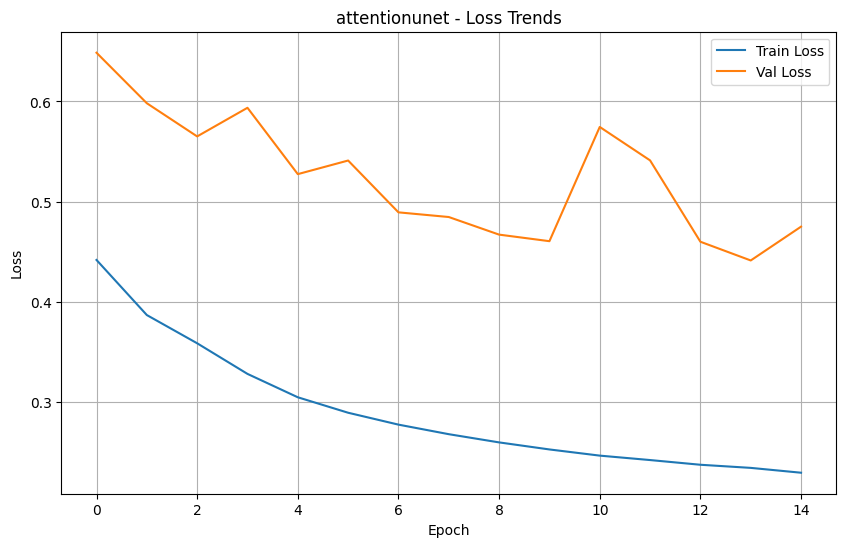

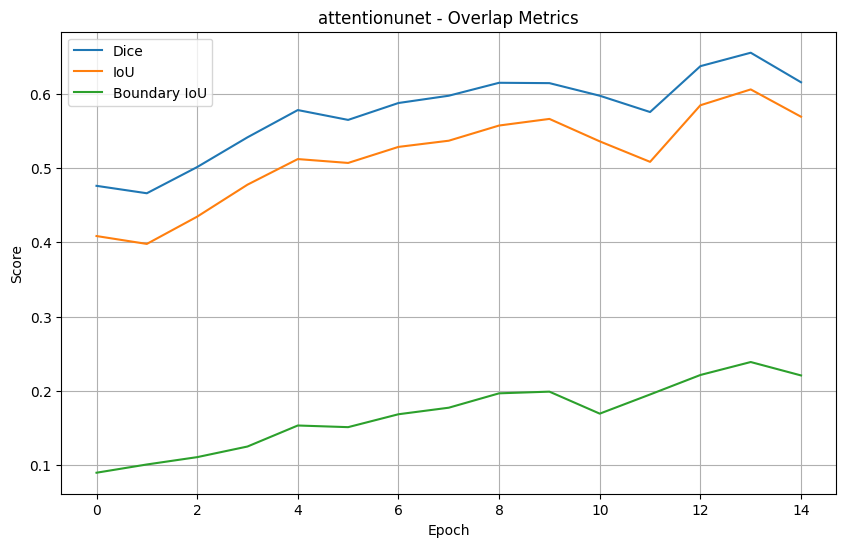

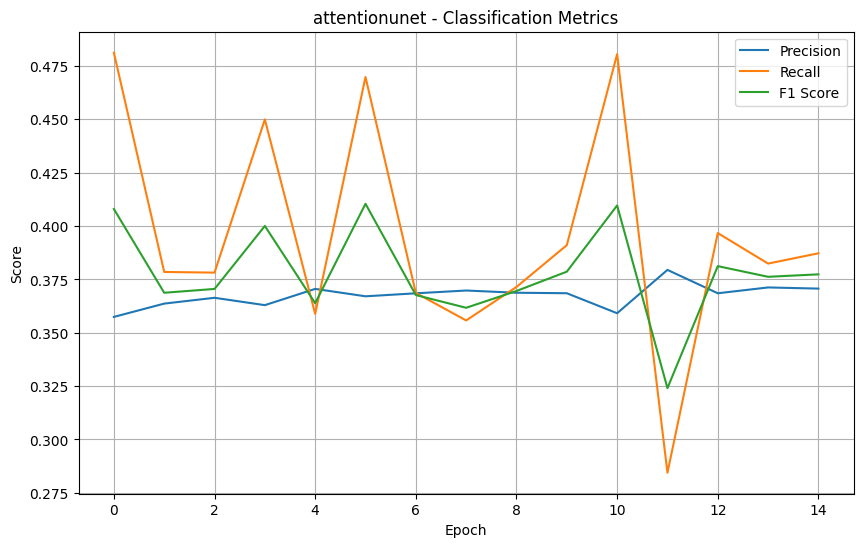

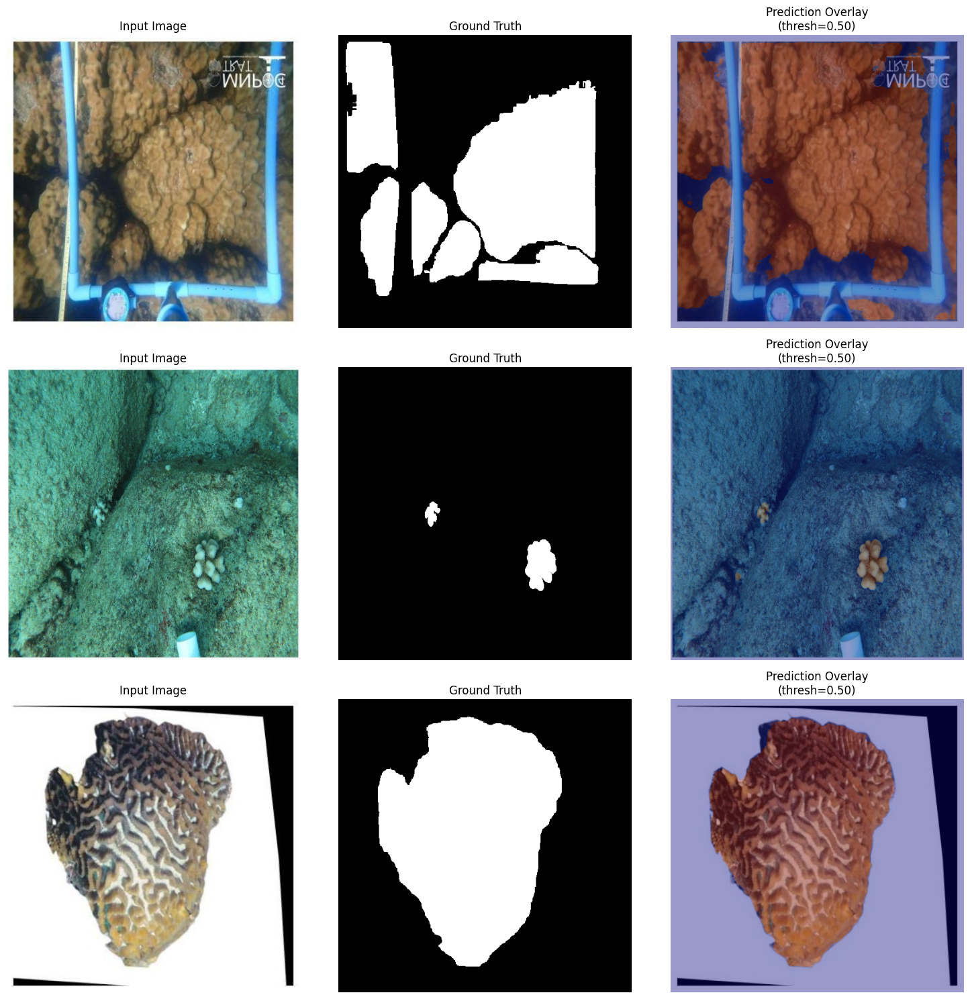


🧼 Evaluating post-processing for model: ATTENTIONUNET
🔬 Metric Comparison (Before vs. After Post-processing):


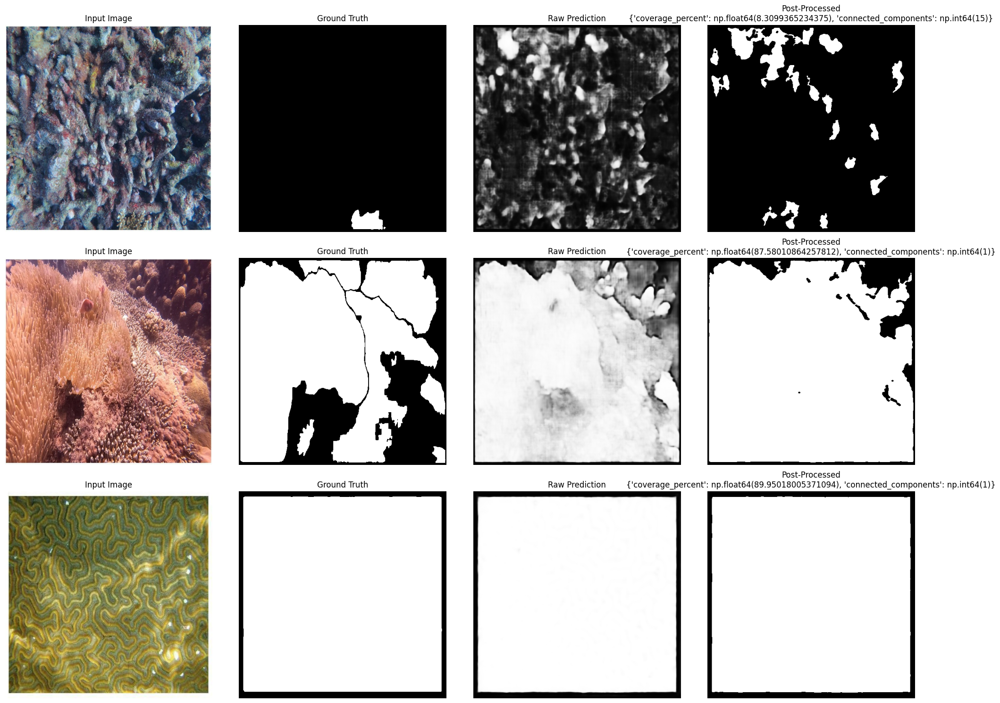


📦 Loading best model for ATTENTIONUNET from: best_model_attentionunet.pth

📊 Final Test Set Metrics for ATTENTIONUNET:
Dice:         0.6545
IoU:          0.6053
Boundary IoU: 0.2390
Precision:    0.8122
Recall:       0.8344
F1 Score:     0.8220

⏱️ ATTENTIONUNET completed in 250.33 minutes.

🔧 Training model: HYBRIDNET

Model: hybridnet | Input: torch.Size([1, 3, 512, 512]) | Output: torch.Size([1, 1, 512, 512])
Model parameters: 11.10M
Pos Weight = 1.4300010204315186


Epoch 1/15: 100%|██████████| 2382/2382 [05:21<00:00,  7.42it/s, loss=0.6655]


Best model updated (Val Loss: 0.6767)
Checkpoint saved: hybridnetv3_epoch1.pth
Epoch 1 | Train Loss: 0.4436 | Val Loss: 0.6767 | Dice: 0.4540 | Precision: 0.3592 | Recall: 0.4792 | F1: 0.4079
Current learning rate: 0.000096


Epoch 2/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.51it/s, loss=0.3078]


Best model updated (Val Loss: 0.6688)
Checkpoint saved: hybridnetv3_epoch2.pth
Epoch 2 | Train Loss: 0.4065 | Val Loss: 0.6688 | Dice: 0.4742 | Precision: 0.3577 | Recall: 0.5093 | F1: 0.4178
Current learning rate: 0.000096


Epoch 3/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.51it/s, loss=0.6459]


Best model updated (Val Loss: 0.5950)
Checkpoint saved: hybridnetv3_epoch3.pth
Epoch 3 | Train Loss: 0.3828 | Val Loss: 0.5950 | Dice: 0.4859 | Precision: 0.3616 | Recall: 0.4322 | F1: 0.3919
Current learning rate: 0.000097


Epoch 4/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.50it/s, loss=0.2195]


Best model updated (Val Loss: 0.5547)
Checkpoint saved: hybridnetv3_epoch4.pth
Epoch 4 | Train Loss: 0.3631 | Val Loss: 0.5547 | Dice: 0.4900 | Precision: 0.3653 | Recall: 0.3767 | F1: 0.3690
Current learning rate: 0.000097


Epoch 5/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.50it/s, loss=0.9930]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: hybridnetv3_epoch5.pth
Epoch 5 | Train Loss: 0.3457 | Val Loss: 0.5847 | Dice: 0.5185 | Precision: 0.3604 | Recall: 0.4474 | F1: 0.3976
Current learning rate: 0.000097


Epoch 6/15: 100%|██████████| 2382/2382 [05:19<00:00,  7.45it/s, loss=0.3022]


Best model updated (Val Loss: 0.5508)
Checkpoint saved: hybridnetv3_epoch6.pth
Epoch 6 | Train Loss: 0.3301 | Val Loss: 0.5508 | Dice: 0.5299 | Precision: 0.3643 | Recall: 0.4022 | F1: 0.3809
Current learning rate: 0.000097


Epoch 7/15: 100%|██████████| 2382/2382 [05:19<00:00,  7.46it/s, loss=0.4233]


Best model updated (Val Loss: 0.5162)
Checkpoint saved: hybridnetv3_epoch7.pth
Epoch 7 | Train Loss: 0.3183 | Val Loss: 0.5162 | Dice: 0.5400 | Precision: 0.3685 | Recall: 0.3900 | F1: 0.3772
Current learning rate: 0.000097


Epoch 8/15: 100%|██████████| 2382/2382 [05:19<00:00,  7.46it/s, loss=0.6452]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: hybridnetv3_epoch8.pth
Epoch 8 | Train Loss: 0.3071 | Val Loss: 0.5266 | Dice: 0.5403 | Precision: 0.3663 | Recall: 0.3773 | F1: 0.3700
Current learning rate: 0.000097


Epoch 9/15: 100%|██████████| 2382/2382 [05:19<00:00,  7.45it/s, loss=0.9092]


No improvement in val loss for 2 epoch(s)
Checkpoint saved: hybridnetv3_epoch9.pth
Epoch 9 | Train Loss: 0.2959 | Val Loss: 0.5266 | Dice: 0.5483 | Precision: 0.3647 | Recall: 0.4335 | F1: 0.3941
Current learning rate: 0.000097


Epoch 10/15: 100%|██████████| 2382/2382 [05:18<00:00,  7.48it/s, loss=0.4723]


Best model updated (Val Loss: 0.5089)
Checkpoint saved: hybridnetv3_epoch10.pth
Epoch 10 | Train Loss: 0.2886 | Val Loss: 0.5089 | Dice: 0.5605 | Precision: 0.3660 | Recall: 0.4058 | F1: 0.3834
Current learning rate: 0.000097


Epoch 11/15: 100%|██████████| 2382/2382 [05:18<00:00,  7.48it/s, loss=0.3125]


Best model updated (Val Loss: 0.5034)
Checkpoint saved: hybridnetv3_epoch11.pth
Epoch 11 | Train Loss: 0.2807 | Val Loss: 0.5034 | Dice: 0.5764 | Precision: 0.3663 | Recall: 0.3933 | F1: 0.3783
Current learning rate: 0.000098


Epoch 12/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.51it/s, loss=0.5390]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: hybridnetv3_epoch12.pth
Epoch 12 | Train Loss: 0.2749 | Val Loss: 0.5108 | Dice: 0.5803 | Precision: 0.3651 | Recall: 0.4131 | F1: 0.3860
Current learning rate: 0.000097


Epoch 13/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.51it/s, loss=0.4525]


Best model updated (Val Loss: 0.4922)
Checkpoint saved: hybridnetv3_epoch13.pth
Epoch 13 | Train Loss: 0.2682 | Val Loss: 0.4922 | Dice: 0.5966 | Precision: 0.3646 | Recall: 0.4029 | F1: 0.3816
Current learning rate: 0.000098


Epoch 14/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.50it/s, loss=0.5664]


Best model updated (Val Loss: 0.4849)
Checkpoint saved: hybridnetv3_epoch14.pth
Epoch 14 | Train Loss: 0.2632 | Val Loss: 0.4849 | Dice: 0.5959 | Precision: 0.3690 | Recall: 0.3724 | F1: 0.3698
Current learning rate: 0.000098


Epoch 15/15: 100%|██████████| 2382/2382 [05:17<00:00,  7.51it/s, loss=0.4665]


Best model updated (Val Loss: 0.4729)
Checkpoint saved: hybridnetv3_epoch15.pth
Epoch 15 | Train Loss: 0.2582 | Val Loss: 0.4729 | Dice: 0.5944 | Precision: 0.3654 | Recall: 0.4064 | F1: 0.3834
Current learning rate: 0.000098
📊 Best threshold for hybridnet: 0.60


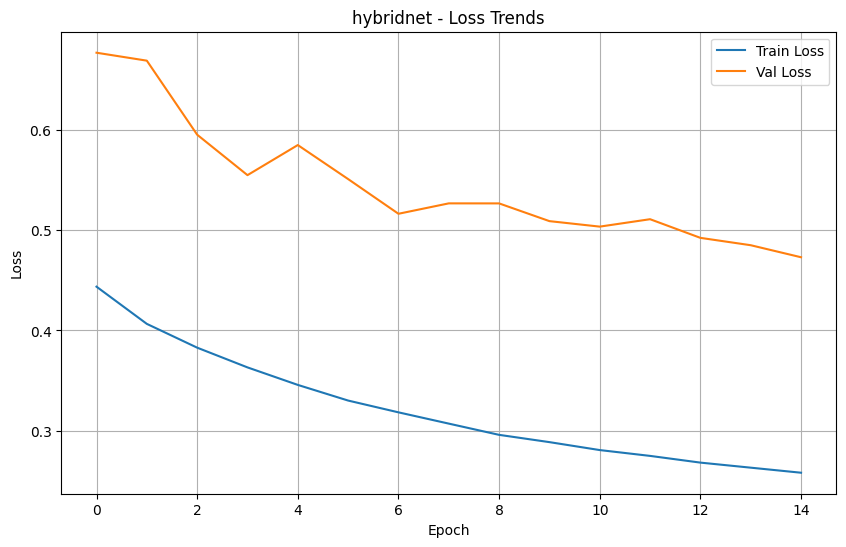

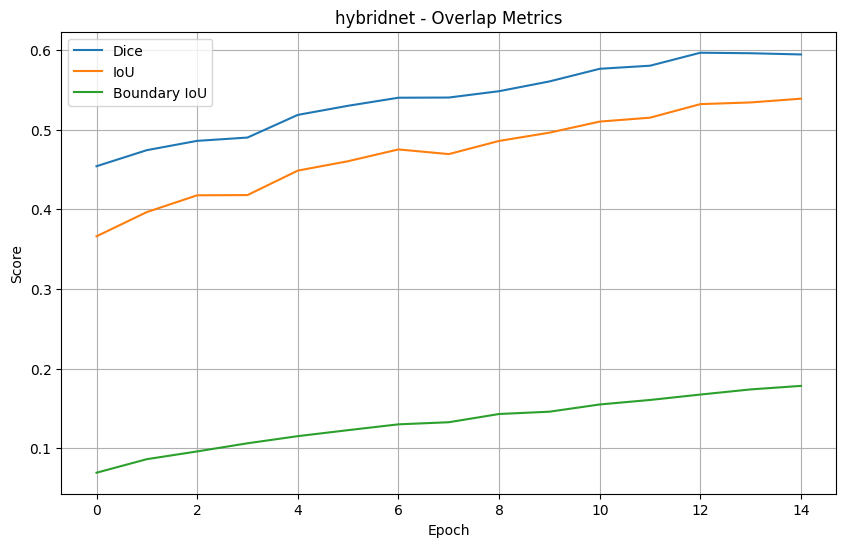

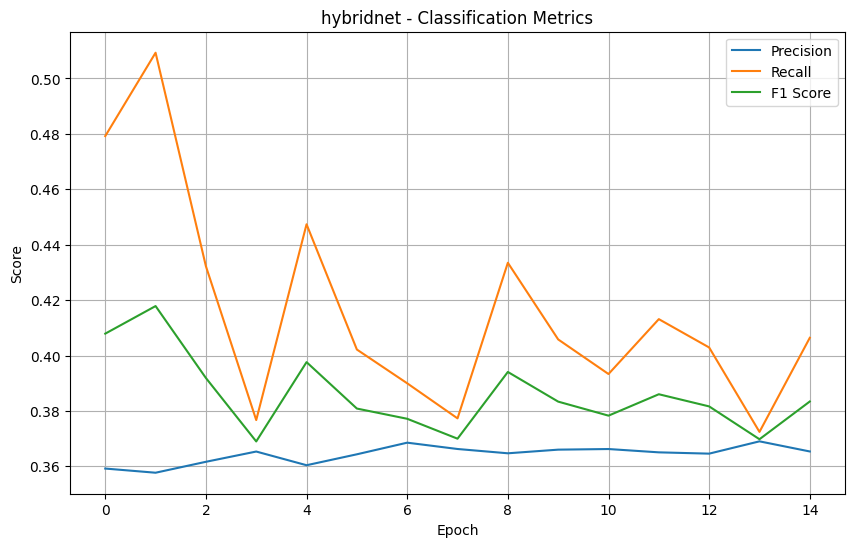

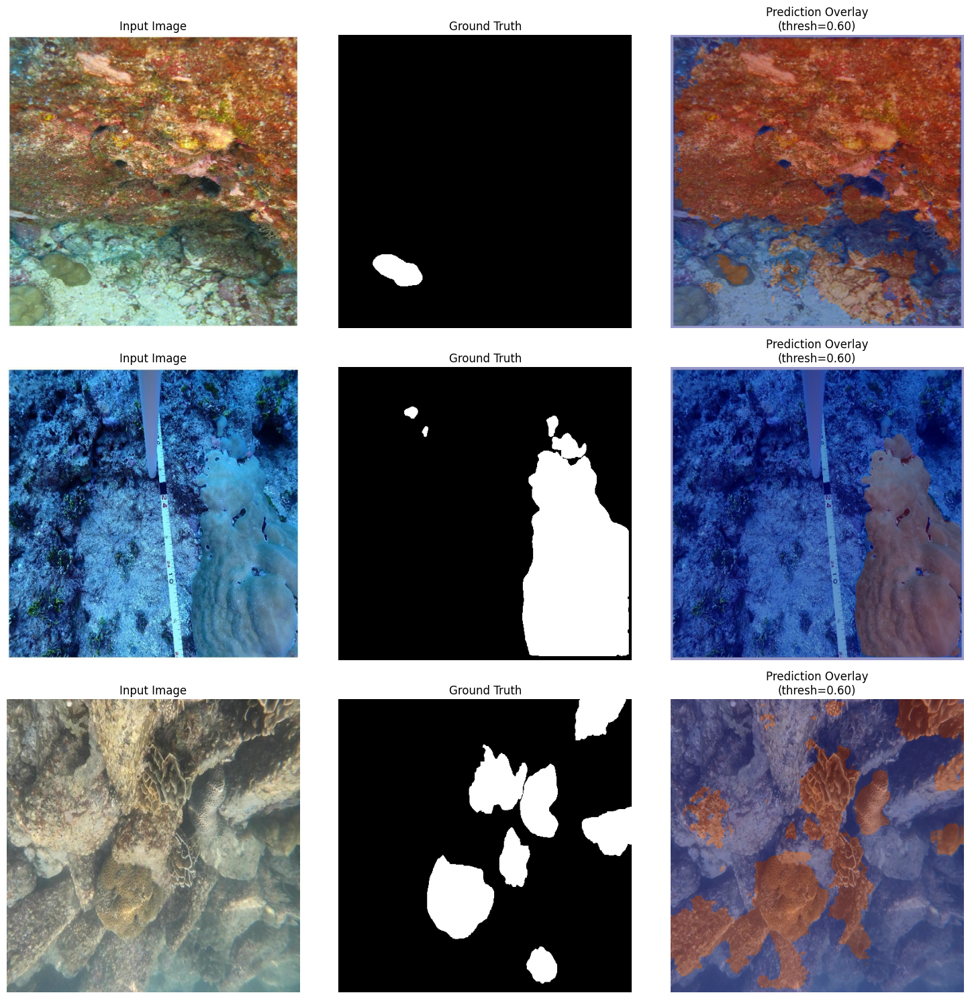


🧼 Evaluating post-processing for model: HYBRIDNET
🔬 Metric Comparison (Before vs. After Post-processing):


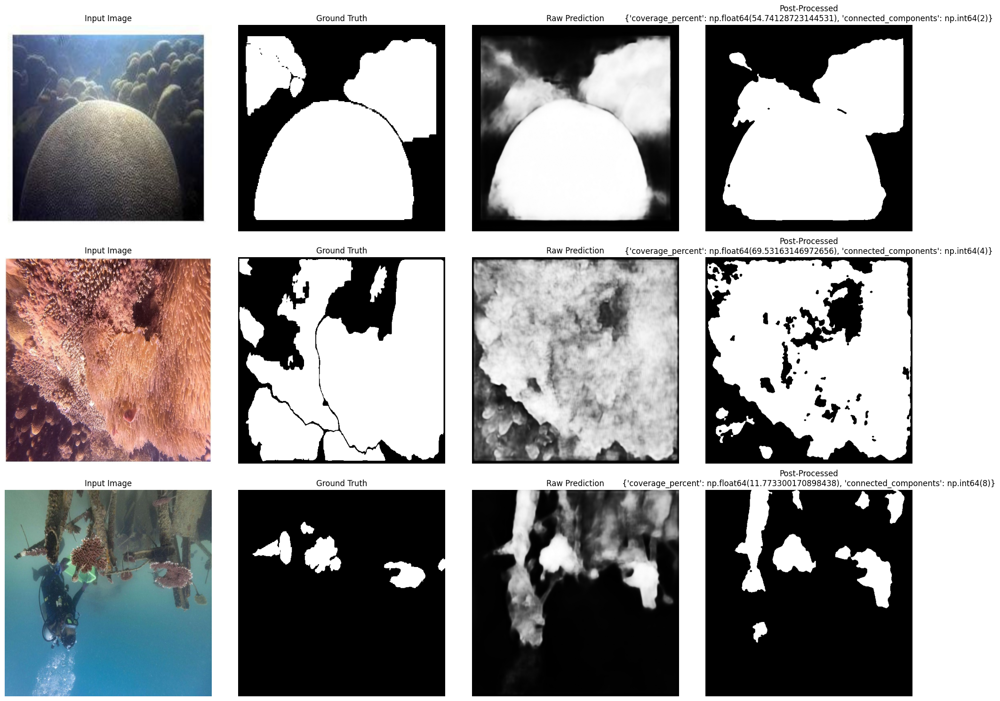

❌ Best model checkpoint not found: best_model_hybridnet.pth

⏱️ HYBRIDNET completed in 86.37 minutes.

🔧 Training model: HRNET

Model: hrnet | Input: torch.Size([1, 3, 512, 512]) | Output: torch.Size([1, 1, 512, 512])
Model parameters: 46.93M
Pos Weight = 1.4300010204315186


Epoch 1/15: 100%|██████████| 2382/2382 [07:12<00:00,  5.51it/s, loss=0.3771]


Best model updated (Val Loss: 0.6207)
Checkpoint saved: hrnetv2_epoch1.pth
Epoch 1 | Train Loss: 0.4406 | Val Loss: 0.6207 | Dice: 0.4856 | Precision: 0.3597 | Recall: 0.4596 | F1: 0.4020
Current learning rate: 0.000096


Epoch 2/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.53it/s, loss=0.3264]


Best model updated (Val Loss: 0.5557)
Checkpoint saved: hrnetv2_epoch2.pth
Epoch 2 | Train Loss: 0.3460 | Val Loss: 0.5557 | Dice: 0.5325 | Precision: 0.3648 | Recall: 0.4074 | F1: 0.3836
Current learning rate: 0.000097


Epoch 3/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.53it/s, loss=0.2416]


Best model updated (Val Loss: 0.4931)
Checkpoint saved: hrnetv2_epoch3.pth
Epoch 3 | Train Loss: 0.3015 | Val Loss: 0.4931 | Dice: 0.5707 | Precision: 0.3690 | Recall: 0.3717 | F1: 0.3696
Current learning rate: 0.000098


Epoch 4/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.7560]


Best model updated (Val Loss: 0.4681)
Checkpoint saved: hrnetv2_epoch4.pth
Epoch 4 | Train Loss: 0.2792 | Val Loss: 0.4681 | Dice: 0.5945 | Precision: 0.3672 | Recall: 0.4036 | F1: 0.3838
Current learning rate: 0.000098


Epoch 5/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.3319]


Best model updated (Val Loss: 0.4528)
Checkpoint saved: hrnetv2_epoch5.pth
Epoch 5 | Train Loss: 0.2647 | Val Loss: 0.4528 | Dice: 0.6154 | Precision: 0.3721 | Recall: 0.3627 | F1: 0.3667
Current learning rate: 0.000098


Epoch 6/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.1842]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: hrnetv2_epoch6.pth
Epoch 6 | Train Loss: 0.2534 | Val Loss: 0.4537 | Dice: 0.6051 | Precision: 0.3725 | Recall: 0.3659 | F1: 0.3685
Current learning rate: 0.000098


Epoch 7/15: 100%|██████████| 2382/2382 [07:12<00:00,  5.51it/s, loss=0.1640]


No improvement in val loss for 2 epoch(s)
Checkpoint saved: hrnetv2_epoch7.pth
Epoch 7 | Train Loss: 0.2447 | Val Loss: 0.4710 | Dice: 0.6377 | Precision: 0.3663 | Recall: 0.4199 | F1: 0.3908
Current learning rate: 0.000098


Epoch 8/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.4379]


Best model updated (Val Loss: 0.4526)
Checkpoint saved: hrnetv2_epoch8.pth
Epoch 8 | Train Loss: 0.2374 | Val Loss: 0.4526 | Dice: 0.6362 | Precision: 0.3667 | Recall: 0.4021 | F1: 0.3827
Current learning rate: 0.000098


Epoch 9/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.3414]


Best model updated (Val Loss: 0.4292)
Checkpoint saved: hrnetv2_epoch9.pth
Epoch 9 | Train Loss: 0.2326 | Val Loss: 0.4292 | Dice: 0.6594 | Precision: 0.3686 | Recall: 0.3863 | F1: 0.3767
Current learning rate: 0.000098


Epoch 10/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.2543]


Best model updated (Val Loss: 0.4279)
Checkpoint saved: hrnetv2_epoch10.pth
Epoch 10 | Train Loss: 0.2258 | Val Loss: 0.4279 | Dice: 0.6555 | Precision: 0.3731 | Recall: 0.3605 | F1: 0.3662
Current learning rate: 0.000098


Epoch 11/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.3618]


Best model updated (Val Loss: 0.4244)
Checkpoint saved: hrnetv2_epoch11.pth
Epoch 11 | Train Loss: 0.2224 | Val Loss: 0.4244 | Dice: 0.6704 | Precision: 0.3718 | Recall: 0.3698 | F1: 0.3704
Current learning rate: 0.000098


Epoch 12/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.2611]


Best model updated (Val Loss: 0.4157)
Checkpoint saved: hrnetv2_epoch12.pth
Epoch 12 | Train Loss: 0.2190 | Val Loss: 0.4157 | Dice: 0.6623 | Precision: 0.3688 | Recall: 0.4014 | F1: 0.3838
Current learning rate: 0.000098


Epoch 13/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.6190]


No improvement in val loss for 1 epoch(s)
Checkpoint saved: hrnetv2_epoch13.pth
Epoch 13 | Train Loss: 0.2148 | Val Loss: 0.4202 | Dice: 0.6689 | Precision: 0.3685 | Recall: 0.3900 | F1: 0.3785
Current learning rate: 0.000098


Epoch 14/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.2060]


No improvement in val loss for 2 epoch(s)
Checkpoint saved: hrnetv2_epoch14.pth
Epoch 14 | Train Loss: 0.2117 | Val Loss: 0.4176 | Dice: 0.6827 | Precision: 0.3715 | Recall: 0.3688 | F1: 0.3697
Current learning rate: 0.000098


Epoch 15/15: 100%|██████████| 2382/2382 [07:11<00:00,  5.52it/s, loss=0.1478]


No improvement in val loss for 3 epoch(s)
Checkpoint saved: hrnetv2_epoch15.pth
Epoch 15 | Train Loss: 0.2096 | Val Loss: 0.4257 | Dice: 0.6766 | Precision: 0.3679 | Recall: 0.3987 | F1: 0.3822
Current learning rate: 0.000098
📊 Best threshold for hrnet: 0.60


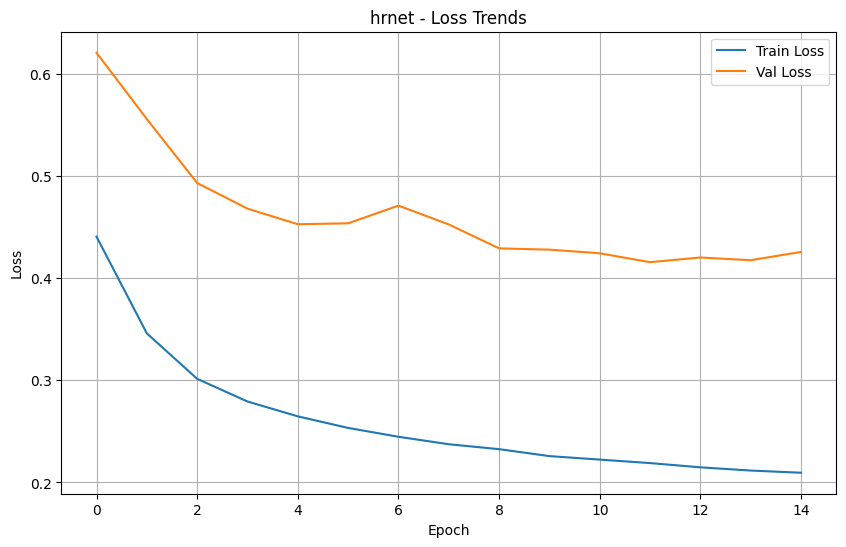

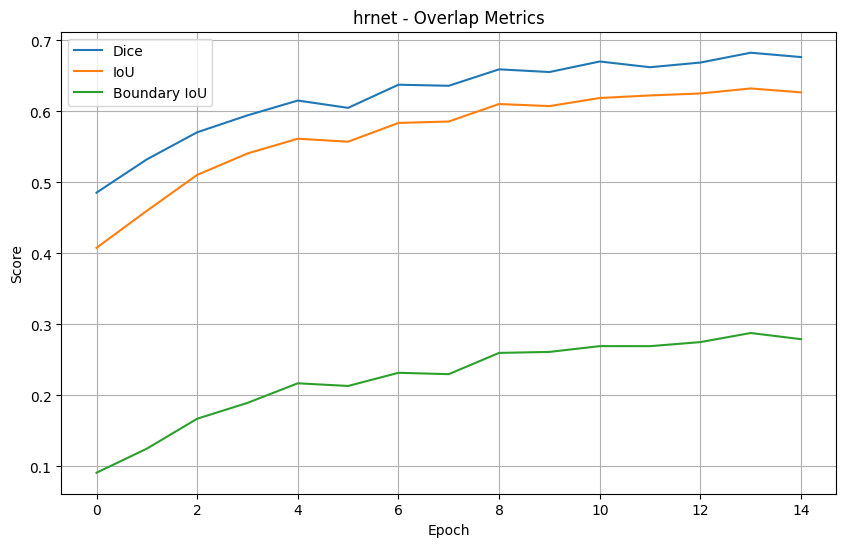

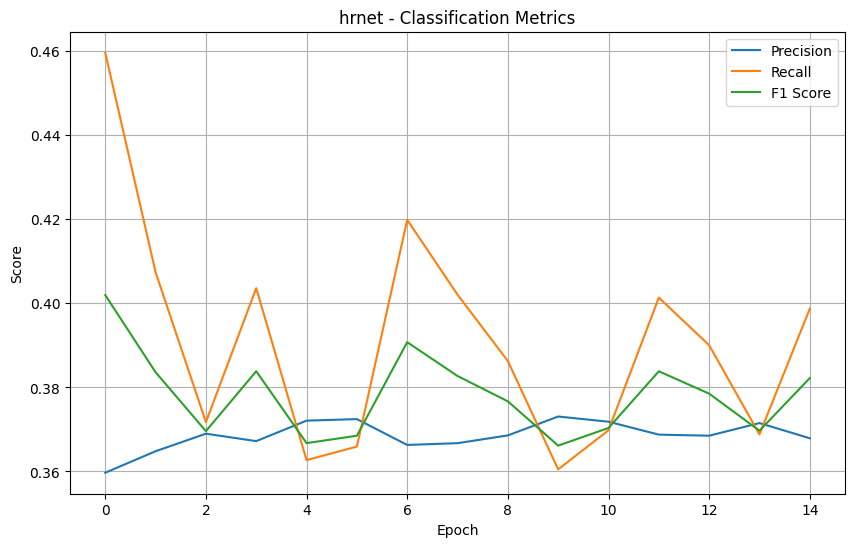

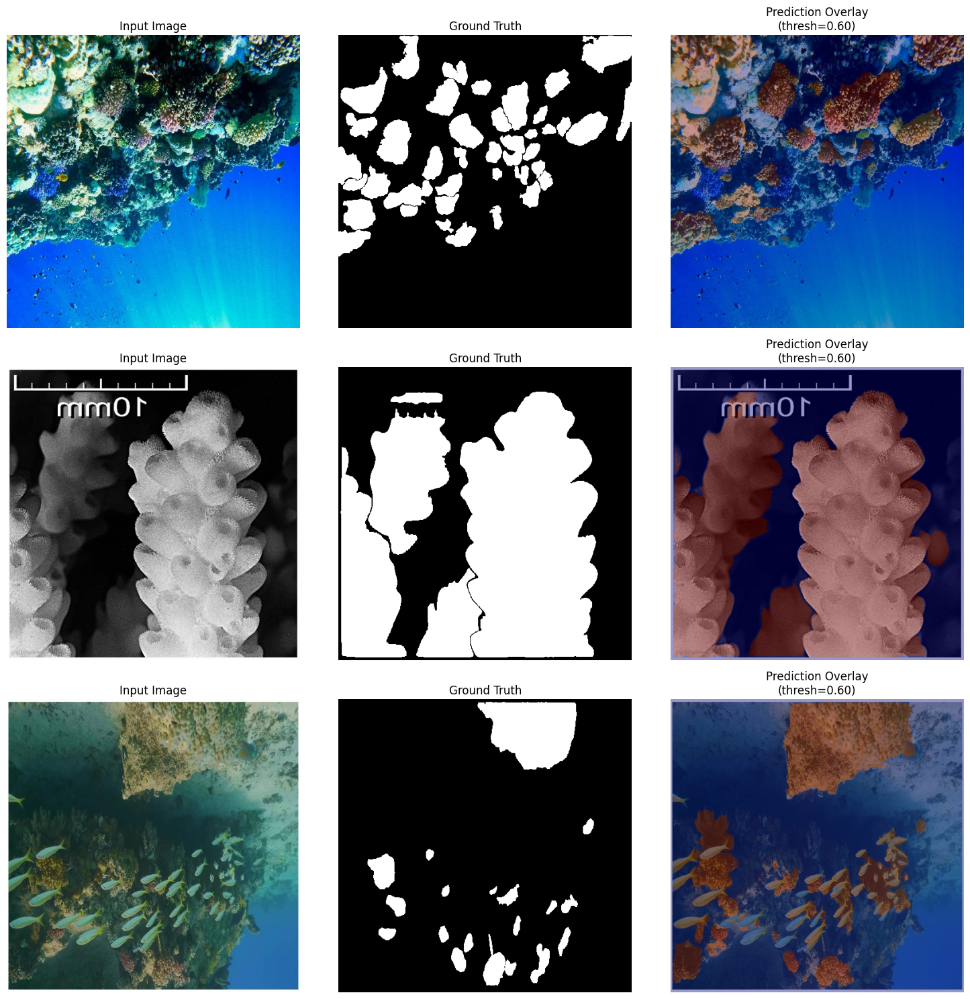


🧼 Evaluating post-processing for model: HRNET
🔬 Metric Comparison (Before vs. After Post-processing):


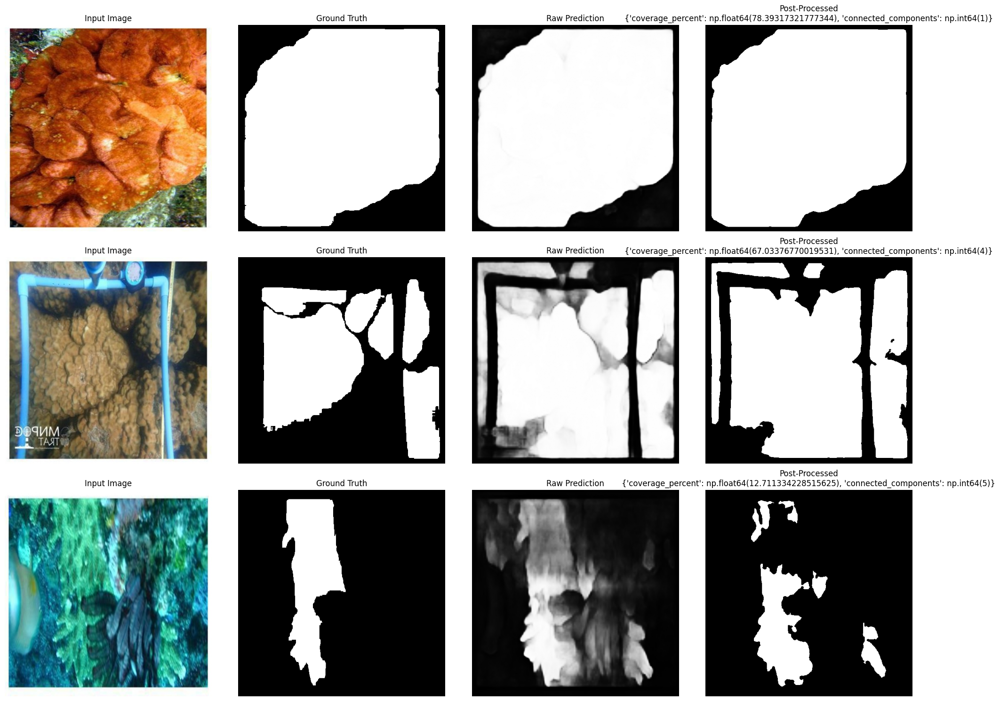

❌ Best model checkpoint not found: best_model_hrnet.pth

⏱️ HRNET completed in 115.69 minutes.


In [17]:
#%% Main Execution for A100 GPU Colab Runtime
import torch.backends.cudnn as cudnn
import time

if __name__ == "__main__":
    DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    cudnn.benchmark = True
    print(f"Running on: {DEVICE} | GPU: {torch.cuda.get_device_name(0)}")

    for model_choice in ["attentionunet", "hybridnet", "hrnet"]:
        start_time = time.time()
        print(f"\n🔧 Training model: {model_choice.upper()}")

        model = initialize_model(name=model_choice).to(DEVICE)
        model_name = model_choice

        train_dataset = CoralDataset(BASE_DIR / "train" / "images_processed",
                                     BASE_DIR / "train" / "masks", transform=train_transform)
        val_dataset = CoralDataset(BASE_DIR / "test" / "images_processed",
                                   BASE_DIR / "test" / "masks", transform=train_transform)

        train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE,
                                  shuffle=True, num_workers=4, pin_memory=True)
        val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE,
                                shuffle=False, num_workers=4, pin_memory=True)

        history = train_model(model, train_loader, val_loader, epochs=15)
        best_threshold = tune_threshold(val_loader, model)
        print(f"📊 Best threshold for {model_choice}: {best_threshold:.2f}")

        # Plotting
        def save_combined_plot(metrics_dict, title, ylabel, filename):
            plt.figure(figsize=(10, 6))
            for label, values in metrics_dict.items():
                if values:
                    plt.plot(values, label=label)
            plt.xlabel("Epoch")
            plt.ylabel(ylabel)
            plt.title(title)
            plt.legend()
            plt.grid(True)
            plt.savefig(BASE_DIR / filename)
            plt.show()

        save_combined_plot(
            {"Train Loss": history['train_loss'], "Val Loss": history['val_loss']},
            title=f"{model_choice} - Loss Trends", ylabel="Loss",
            filename=f"{model_choice}_loss_trends.png"
        )

        save_combined_plot(
            {"Dice": history['dice'], "IoU": history['iou'], "Boundary IoU": history['boundary_iou']},
            title=f"{model_choice} - Overlap Metrics", ylabel="Score",
            filename=f"{model_choice}_overlap_metrics.png"
        )

        save_combined_plot(
            {"Precision": history['precision'], "Recall": history['recall'], "F1 Score": history['f1']},
            title=f"{model_choice} - Classification Metrics", ylabel="Score",
            filename=f"{model_choice}_classification_metrics.png"
        )

        visualize_predictions(model, val_dataset, threshold=best_threshold)
        visualize_misclassifications(model, val_dataset, threshold=best_threshold, num_samples=10)

        print(f"\n🧼 Evaluating post-processing for model: {model_choice.upper()}")
        evaluate_postprocessing(model, val_loader, threshold=best_threshold)
        visualize_postprocessing(model, val_dataset, threshold=best_threshold)

        # Optional checkpoint re-evaluation
        if model_choice == "deeplab":
            checkpoint_path = BASE_DIR / f"checkpoints_deeplabv3plusdecoder" / "deeplabv3plusdecoder_epoch11.pth"
            if checkpoint_path.exists():
                print(f"\n📦 Loading checkpoint: {checkpoint_path.name}")
                model.load_state_dict(torch.load(checkpoint_path, map_location=DEVICE))
                model.eval()

                total_dice = total_iou = total_biou = total_precision = total_recall = total_f1 = 0.0
                n = 0
                with torch.no_grad():
                    for images, masks in val_loader:
                        images, masks = images.to(DEVICE), masks.to(DEVICE)
                        outputs = model(images).sigmoid().squeeze(1)
                        total_dice += dice_coeff(outputs, masks.squeeze(1)).item()
                        total_iou += compute_iou(outputs, masks.squeeze(1))
                        total_biou += boundary_iou(outputs, masks.squeeze(1))
                        p, r, f1 = compute_metrics(outputs, masks.squeeze(1))
                        total_precision += p
                        total_recall += r
                        total_f1 += f1
                        n += 1

                print("\n📊 Metrics for deeplabv3plusdecoder_epoch11.pth:")
                print(f"Dice:         {total_dice / n:.4f}")
                print(f"IoU:          {total_iou / n:.4f}")
                print(f"Boundary IoU: {total_biou / n:.4f}")
                print(f"Precision:    {total_precision / n:.4f}")
                print(f"Recall:       {total_recall / n:.4f}")
                print(f"F1 Score:     {total_f1 / n:.4f}")
            else:
                print("❌ Checkpoint deeplabv3plusdecoder_epoch11.pth not found.")

        # Final evaluation
        best_model_path = BASE_DIR / f"best_model_{model_name}.pth"
        if best_model_path.exists():
            print(f"\n📦 Loading best model for {model_name.upper()} from: {best_model_path.name}")
            model.load_state_dict(torch.load(best_model_path, map_location=DEVICE))
            model.eval()

            test_loader = DataLoader(
                CoralDataset(BASE_DIR / "test" / "images_processed", BASE_DIR / "test" / "masks", transform=train_transform),
                batch_size=BATCH_SIZE, shuffle=False, num_workers=4, pin_memory=True
            )

            total_dice = total_iou = total_biou = total_precision = total_recall = total_f1 = 0.0
            n = len(test_loader)

            with torch.no_grad():
                for images, masks in test_loader:
                    images, masks = images.to(DEVICE), masks.to(DEVICE)
                    outputs = model(images).sigmoid().squeeze(1)
                    total_dice += dice_coeff(outputs, masks.squeeze(1)).item()
                    total_iou += compute_iou(outputs, masks.squeeze(1))
                    total_biou += boundary_iou(outputs, masks.squeeze(1))
                    p, r, f1 = compute_metrics(outputs, masks.squeeze(1))
                    total_precision += p
                    total_recall += r
                    total_f1 += f1

            print(f"\n📊 Final Test Set Metrics for {model_name.upper()}:")
            print(f"Dice:         {total_dice / n:.4f}")
            print(f"IoU:          {total_iou / n:.4f}")
            print(f"Boundary IoU: {total_biou / n:.4f}")
            print(f"Precision:    {total_precision / n:.4f}")
            print(f"Recall:       {total_recall / n:.4f}")
            print(f"F1 Score:     {total_f1 / n:.4f}")
        else:
            print(f"❌ Best model checkpoint not found: {best_model_path.name}")

        elapsed = (time.time() - start_time) / 60
        print(f"\n⏱️ {model_choice.upper()} completed in {elapsed:.2f} minutes.")